In [1]:
!pip install Twython
import pandas as pd
import numpy as np 
from twython import Twython
from twython import TwythonError
import requests
from bs4 import BeautifulSoup
from datetime import datetime
import ast
import time
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from collections import Counter
from nltk.corpus import stopwords
from nltk.util import ngrams
from sklearn.feature_extraction.text import CountVectorizer
plt.style.use('ggplot')

CONSUMER_KEY = "DyoTjohC4arsxLFBjmh71l5Fi"
CONSUMER_SECRET = "sWE3WV27dOOsZnRpSo19bZCojZykVqftYh1uAQvCwqviro4jT1"
OAUTH_TOKEN = "1133494860554604545-aQrvZDpNyxgi6MwQbHegX8Bkx6CUfI"
OAUTH_TOKEN_SECRET = "inqueIKTVIqqKGXKiHS7dOwNvSmCQdWgYN83ih1kQkNkS"
twitter = Twython(
    CONSUMER_KEY, CONSUMER_SECRET,
    OAUTH_TOKEN, OAUTH_TOKEN_SECRET)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


#  #ΝέαΔημοκρατία

In [2]:
tweets = []
MAX_ATTEMPTS = 50
COUNT_OF_TWEETS_TO_BE_FETCHED = 10000 

for i in range(0,MAX_ATTEMPTS):

    if(COUNT_OF_TWEETS_TO_BE_FETCHED < len(tweets)):
        print("We Got ", len(tweets), " tweets!!!")
        break # we got the  tweets... !!

    #----------------------------------------------------------------#
    # STEP 1: Query Twitter
    # STEP 2: Save the returned tweets
    # STEP 3: Get the next max_id
    #----------------------------------------------------------------#

    # STEP 1: Query Twitter
    if(0 == i):
        # Query twitter for data. 
        results = twitter.search(q="#κυβερνηση_Μητσοτακη ",count='100')
        print("I Got:", len(results['statuses']), " tweets")
    else:
        # After the first call we should have max_id from result of previous call. Pass it in query.
        results = twitter.search(q="#κυβερνηση_Μητσοτακη ",count='100', include_entities='true',max_id=next_max_id)
        print("I Got:", len(results['statuses']), " tweets")


    # STEP 2: Save the returned tweets
    for result in results['statuses']:
#        tweet_text = result['text']
        tweets.append(result)


    # STEP 3: Get the next max_id
    try:
        # Parse the data returned to get max_id to be passed in consequent call.
        next_results_url_params = results['search_metadata']['next_results']
        next_max_id = next_results_url_params.split('max_id=')[1].split('&')[0]
    except:
        # No more next pages
        break

I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets


In [3]:
#results['search_metadata']

In [4]:
#results['statuses']

In [5]:
tweets_df = pd.DataFrame(tweets)
tweets_df

,created_at,id,id_str,text,truncated,entities,metadata,source,in_reply_to_status_id,in_reply_to_status_id_str,...,retweet_count,favorite_count,favorited,retweeted,lang,possibly_sensitive,quoted_status_id,quoted_status_id_str,quoted_status,extended_entities
0,Sun Jul 10 12:16:06 +0000 2022,1546105983235129348,1546105983235129348,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...,False,"{'hashtags': [{'text': 'ΣΥΡΙΖΑ', 'indices': [4...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""https://mobile.twitter.com"" rel=""nofo...",NaN,None,...,11,0,False,False,el,NaN,NaN,NaN,NaN,NaN
1,Sun Jul 10 12:14:11 +0000 2022,1546105500638609413,1546105500638609413,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,False,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1,0,False,False,el,NaN,NaN,NaN,NaN,NaN
2,Sun Jul 10 12:11:55 +0000 2022,1546104930683047936,1546104930683047936,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...",True,"{'hashtags': [{'text': 'κυβερνηση_τσιρκο', 'in...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,0,0,False,False,el,False,NaN,NaN,NaN,NaN
3,Sun Jul 10 11:58:37 +0000 2022,1546101584039448576,1546101584039448576,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...,True,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,0,0,False,False,el,True,NaN,NaN,NaN,NaN
4,Sun Jul 10 11:49:56 +0000 2022,1546099397297340416,1546099397297340416,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ...",False,"{'hashtags': [{'text': 'κυβερνηση_Μητσοτακη', ...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,4,0,False,False,el,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,Thu Jun 30 14:39:06 +0000 2022,1542518092810420226,1542518092810420226,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,False,"{'hashtags': [{'text': 'υπερκέρδη', 'indices':...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,10,0,False,False,el,NaN,NaN,NaN,NaN,NaN
4996,Thu Jun 30 14:36:18 +0000 2022,1542517386187665409,1542517386187665409,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,False,"{'hashtags': [{'text': 'υπερκέρδη', 'indices':...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/iphone"" r...",NaN,None,...,10,0,False,False,el,NaN,NaN,NaN,NaN,NaN
4997,Thu Jun 30 14:36:07 +0000 2022,1542517341002469377,1542517341002469377,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...,False,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/iphone"" r...",NaN,None,...,41,0,False,False,el,NaN,NaN,NaN,NaN,NaN
4998,Thu Jun 30 14:34:13 +0000 2022,1542516864835649539,1542516864835649539,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...,False,"{'hashtags': [{'text': 'κυβερνηση_Μητσοτακη', ...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""https://mobile.twitter.com"" rel=""nofo...",NaN,None,...,7,0,False,False,el,NaN,NaN,NaN,NaN,NaN


In [6]:
# Number of tweets the user has made
print("I got :", len(tweets_df), " in total!!!")

I got : 5000  in total!!!


In [7]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [8]:
tweets_df.to_csv("/content/gdrive/My Drive/Colab Notebooks/Νέα_Δημοκρατία_tweet.tsv", sep='\t')

# Νέα ενότητα #Νέα_Δημοκρατία

In [9]:
tweets_df =pd.read_csv("/content/gdrive/My Drive/Colab Notebooks/Νέα_Δημοκρατία_tweet.tsv", sep='\t')

In [10]:
Tweets = tweets_df[['created_at','text' ]]
Tweets = Tweets.rename(columns={'created_at': 'date'} )
Tweets

,date,text
0,Sun Jul 10 12:16:06 +0000 2022,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...
1,Sun Jul 10 12:14:11 +0000 2022,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...
2,Sun Jul 10 12:11:55 +0000 2022,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα..."
3,Sun Jul 10 11:58:37 +0000 2022,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...
4,Sun Jul 10 11:49:56 +0000 2022,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ..."
...,...,...
4995,Thu Jun 30 14:39:06 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4996,Thu Jun 30 14:36:18 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4997,Thu Jun 30 14:36:07 +0000 2022,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...
4998,Thu Jun 30 14:34:13 +0000 2022,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...


In [11]:
#Tweets.dtypes

In [12]:
Tweets['year'] = pd.DatetimeIndex(Tweets['date']).year
Tweets['month'] = pd.DatetimeIndex(Tweets['date']).month
Tweets['day'] = pd.DatetimeIndex(Tweets['date']).day
Tweets

,date,text,year,month,day
0,Sun Jul 10 12:16:06 +0000 2022,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...,2022,7,10
1,Sun Jul 10 12:14:11 +0000 2022,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,2022,7,10
2,Sun Jul 10 12:11:55 +0000 2022,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...",2022,7,10
3,Sun Jul 10 11:58:37 +0000 2022,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...,2022,7,10
4,Sun Jul 10 11:49:56 +0000 2022,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ...",2022,7,10
...,...,...,...,...,...
4995,Thu Jun 30 14:39:06 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30
4996,Thu Jun 30 14:36:18 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30
4997,Thu Jun 30 14:36:07 +0000 2022,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...,2022,6,30
4998,Thu Jun 30 14:34:13 +0000 2022,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...,2022,6,30


In [13]:
Tweets['text'] = Tweets['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.


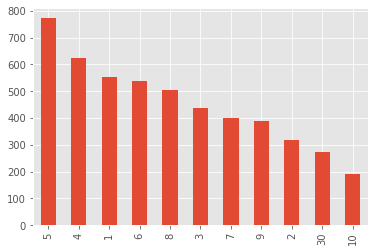

In [14]:
Tweets['day'].value_counts().plot(kind='bar')

In [15]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

In [16]:
Tweets[Tweets['year']==2022]['text']

0       RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...
1       RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...
2       Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...
3       Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...
4       RT @Zoapotomisthom1: "… Στην ΕΛΛΑΔΑ 2.0 η #κυβ...
                              ...                        
4995    RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4996    RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4997    RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...
4998    RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...
4999    RT @jWk5pCNPf6Mt28J: Ο άλλος διχοτομησε το Αιγ...
Name: text, Length: 5000, dtype: object

In [17]:
# Ισως καποτε χρειαστεί να αφαιρέσουμε τους τόνους.....
text = Tweets['text'].str.replace('ά','α').str.replace("έ", "ε").str.replace('ή','η').str.replace('ί','ι').str.replace('ό','ο').str.replace('ύ','υ').str.replace('ώ','ω')

In [18]:
text = Tweets[Tweets['year']==2022]['text'].str.cat(sep = '.').replace("amp", ' ')
text

'RT @HatredHunter: Το επικοινωνιακό επιτελείο του #ΣΥΡΙΖΑ θα έπρεπε να πληρώνει την Κλείτου και λοιπά μηντιακά ψώνια της #ΝΔ να ποστάρουν τέ….RT @JaneAusten1823: @Pierrakakis @MinDigitalGr @th_livanios @christopoulosgr @DimosthenisAnag @staverisT @ktpae @grnet_gr @idikagr Οι #Ασεπ….Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα τα φοντα να γινει...\n#κυβερνηση_τσιρκο #κυβερνηση_Μητσοτακη…  .Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμβόλιο από την Ουρουγουάη επειδή το δικαστήριο απαίτησε να μάθει το πε…  .RT @Zoapotomisthom1: "… Στην ΕΛΛΑΔΑ 2.0 η #κυβερνηση_Μητσοτακη\nΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα & ; τον ΦΠΑ στα….RT @Zoapotomisthom1: "… Στην ΕΛΛΑΔΑ 2.0 η #κυβερνηση_Μητσοτακη\nΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα & ; τον ΦΠΑ στα….RT @Zoapotomisthom1: "… Στην ΕΛΛΑΔΑ 2.0 η #κυβερνηση_Μητσοτακη\nΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα & ; τον ΦΠΑ στα….RT @Zoapotomisthom1: "… Στην ΕΛΛΑΔΑ 2.0 η #κυβερνηση_Μητσο

In [19]:
list('STOPWORDS')[0:20]

['S', 'T', 'O', 'P', 'W', 'O', 'R', 'D', 'S']

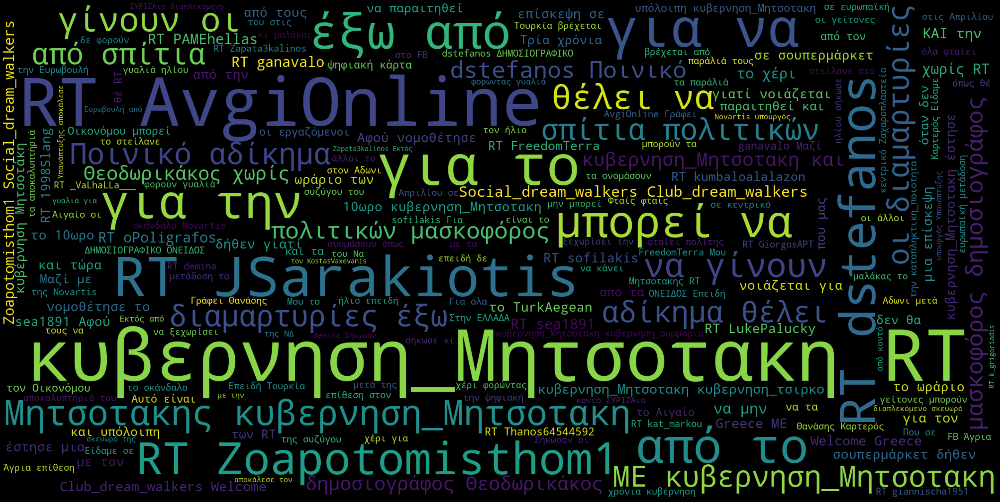

In [20]:
wordcloud = WordCloud(
#   stopwords = STOPWORDS,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [21]:
import spacy
!python -m spacy download el_core_news_sm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.6 MB 631 kB/s 
✔ Download and installation successful
You can now load the package via spacy.load('el_core_news_sm')


In [22]:
nlp = spacy.load('el_core_news_sm')
list(nlp.Defaults.stop_words)[0:20]

['της',
 'τούτης',
 'όλο',
 'αι',
 'είχες',
 'εγώ',
 'ενός',
 'υπέρ',
 'κάμποσους',
 'πρωτύτερα',
 'εκείνους',
 'αν',
 'πόσης',
 'βεβαιότατα',
 'τόση',
 'λιγότερο',
 'να',
 'πέρυσι',
 'δι',
 'μεν']

In [23]:
text = Tweets['text'].str.cat(sep = '.').replace('.','').strip()
text = text.replace('amp','').strip()
text = text.replace('rt','').strip()
text = text.replace('\n','').strip()
text = text.replace(':','').strip()
text

'RT @HatredHunter Το επικοινωνιακό επιτελείο του #ΣΥΡΙΖΑ θα έπρεπε να πληρώνει την Κλείτου και λοιπά μηντιακά ψώνια της #ΝΔ να ποστάρουν τέ…RT @JaneAusten1823 @Pierrakakis @MinDigitalGr @th_livanios @christopoulosgr @DimosthenisAnag @staverisT @ktpae @grnet_gr @idikagr Οι #Ασεπ…Αυτο το site ειναι parody;;;Αν οχι, εχει ολα τα φοντα να γινει#κυβερνηση_τσιρκο #κυβερνηση_Μητσοτακη…  Προκαλεί η Pfizer Προτίμησε να αποσύρει το εμβόλιο από την Ουρουγουάη επειδή το δικαστήριο απαίτησε να μάθει το πε…  RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα &; τον ΦΠΑ στα…RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα &; τον ΦΠΑ στα…RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα &; τον ΦΠΑ στα…RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο

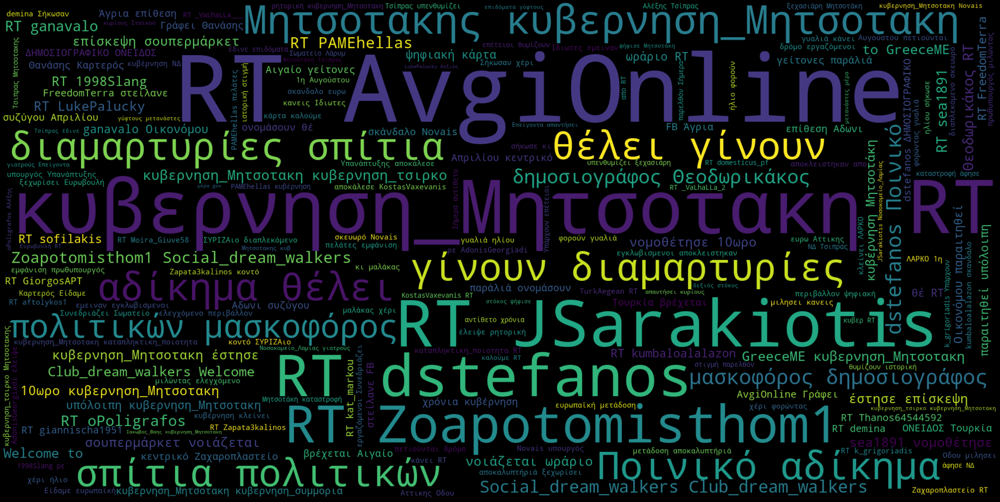

In [24]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [25]:
from PIL import Image
import numpy as np

In [26]:
doc = nlp(Tweets['text'][1])

In [27]:
for token in doc:
    print(token, token.lemma_)

RT RT
@JaneAusten1823 @JaneAusten1823
: :
@Pierrakakis @Pierrakakis
@MinDigitalGr @MinDigitalGr
@th_livanios @th_livanios
@christopoulosgr @christopoulosgr
@DimosthenisAnag @DimosthenisAnag
@staverisT @staverisT
@ktpae @ktpae
@grnet_gr @grnet_gr
@idikagr @idikagr
Οι ο
# #
Ασεπ Ασεπ
… …


In [28]:
' '.join(token.lemma_ for token in doc)
text

'RT @HatredHunter Το επικοινωνιακό επιτελείο του #ΣΥΡΙΖΑ θα έπρεπε να πληρώνει την Κλείτου και λοιπά μηντιακά ψώνια της #ΝΔ να ποστάρουν τέ…RT @JaneAusten1823 @Pierrakakis @MinDigitalGr @th_livanios @christopoulosgr @DimosthenisAnag @staverisT @ktpae @grnet_gr @idikagr Οι #Ασεπ…Αυτο το site ειναι parody;;;Αν οχι, εχει ολα τα φοντα να γινει#κυβερνηση_τσιρκο #κυβερνηση_Μητσοτακη…  Προκαλεί η Pfizer Προτίμησε να αποσύρει το εμβόλιο από την Ουρουγουάη επειδή το δικαστήριο απαίτησε να μάθει το πε…  RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα &; τον ΦΠΑ στα…RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα &; τον ΦΠΑ στα…RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο να μειώσει τον ΕΦΚ στα καύσιμα &; τον ΦΠΑ στα…RT @Zoapotomisthom1 "… Στην ΕΛΛΑΔΑ 20 η #κυβερνηση_ΜητσοτακηΔΕΝ ΒΡΙΣΚΕΙ δημοσιονομικό χώρο

In [29]:
full_doc = nlp(text)

In [30]:
clear_text = ' '.join(token.lemma_ for token in full_doc)
clear_text[200:400]

'stopoulosgr @DimosthenisAnag @staverisT @ktpae @grnet_gr @idikagr ο # Ασεπ … Αυτο ο site ειμαι parody;;;Αν οχι , εχω ολα ο φοντας να γινει#κυβερνηση_τσιρκο # κυβερνηση_Μητσοτακη …   Προκαλώ ο Pfizer π'

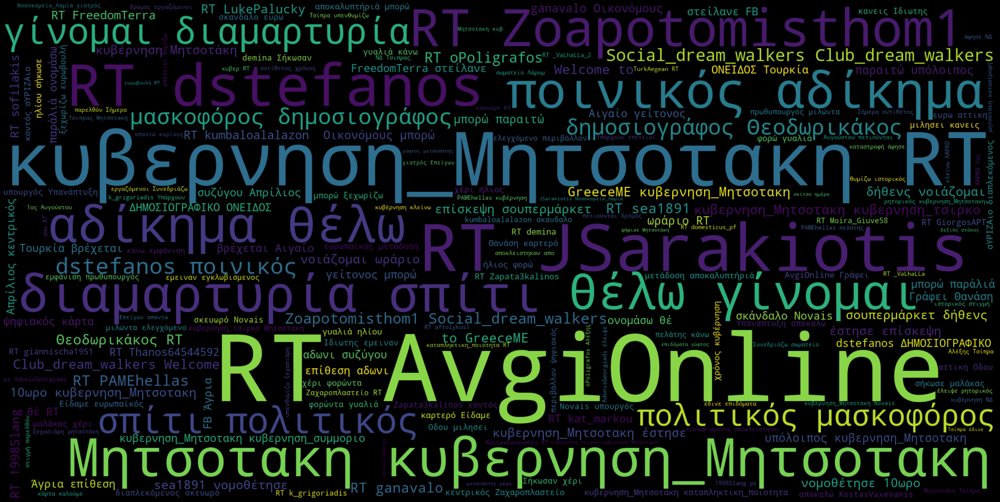

In [31]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(clear_text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [32]:
from collections import Counter
Counter(" ".join(Tweets["text"]).split()).most_common(16)

[('RT', 3801),
 ('το', 1725),
 ('#κυβερνηση_Μητσοτακη', 1698),
 ('να', 1457),
 ('και', 1293),
 ('η', 1156),
 ('ο', 1112),
 ('για', 1091),
 ('την', 1039),
 ('οι', 951),
 ('της', 902),
 ('από', 875),
 ('του', 779),
 ('σε', 755),
 ('που', 736),
 ('τα', 724)]

In [33]:
for word in nlp.Defaults.stop_words:
  print(word)
  break

της


In [34]:
Tweets['text_no_stopwords'] = Tweets['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words) and word != ':' and word != '\n' and word != "amp" and word != 'rt' and word != ',']))
Tweets['text_no_stopwords'] = Tweets['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words)]))
Tweets['clean_text_no_stopwords'] = Tweets['text']
#for stopword in nlp.Defaults.stop_words:
Tweets['clean_text_no_stopwords'] = Tweets['clean_text_no_stopwords'].apply(lambda x: ' '.join([word for word in x.split() if word not in nlp.Defaults.stop_words and word != "ή" and word != "ία" and word != "κι"]))
Tweets['clean_text_no_stopwords'] = Tweets['clean_text_no_stopwords'].apply(lambda x: x.replace("amp", "").strip())
Tweets['clean_text_no_stopwords'] = Tweets['clean_text_no_stopwords'].apply(lambda x: x.replace("rt", "").strip())
Tweets['clean_text_no_stopwords'] = Tweets['clean_text_no_stopwords'].apply(lambda x: x.replace(":", "").strip())
Tweets['clean_text_no_stopwords'] = Tweets['clean_text_no_stopwords'].apply(lambda x: x.replace(",", "").strip())
Tweets['clean_text_no_stopwords'] = Tweets['clean_text_no_stopwords'].apply(lambda x: x.replace("\n", "").strip())
Tweets['clean_text_no_stopwords'] = Tweets['clean_text_no_stopwords'].apply(lambda x: x.replace(".", "").strip())

In [35]:
freq = Counter(" ".join(Tweets["clean_text_no_stopwords"]).split()).most_common(16)
freq

[('RT', 3801),
 ('#κυβερνηση_Μητσοτακη', 1738),
 ('Η', 479),
 ('@AvgiOnline', 424),
 ('#Μητσοτακης', 365),
 ('&;', 279),
 ('@JSarakiotis', 278),
 ('Μητσοτάκη', 226),
 ('@dstefanos', 220),
 ('Ο', 208),
 ('Για', 205),
 ('ν…', 205),
 ('κυβέρνηση', 203),
 ('-', 195),
 ('κ', 179),
 ('#κυβερνηση_τσιρκο', 176)]

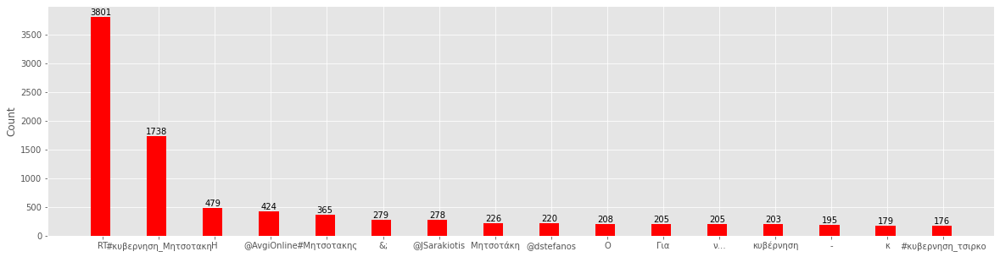

In [36]:
names, values = zip(*freq)
# names = [x[0] for x in data]  # These two lines are equivalent to the the zip-command.
# values = [x[1] for x in data] # These two lines are equivalent to the the zip-command.

ind = np.arange(len(freq))  # the x locations for the groups
width = 0.35       # the width of the bars

fig, ax = plt.subplots(figsize=(20,5))
rects1 = ax.bar(ind, values, width, color='r')
# add some text for labels, title and axes ticks
ax.set_ylabel('Count')
ax.set_xticks(ind+width/10.)
ax.set_xticklabels(names)

def autolabel(rects):
    # attach some text labels
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2, height,
                '%d' % int(height),
                ha='center', va='bottom')

autolabel(rects1)

plt.show()

# Vectorizing Νέα_Δημοκρατία

In [37]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer()

In [38]:
count_vector = cv.fit_transform(Tweets['text'])

In [39]:
count_vector.shape

(5000, 5820)

In [40]:
cv.get_feature_names()

results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,000,0_snarf_007,10,100,108,108η,1095,10άρα,10ωρο,11,...,ότι,όχι,όψει,ύβρις,ύπαρξη,ώρ,ώρα,ώρες,ώριμη,ώστε
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [41]:
#cv.vocabulary_

In [42]:
cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95)

In [43]:
count_vector = cv.fit_transform(Tweets['text'])

In [44]:
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,000,10ωρο,12,1998slang,_valhalla___,adonisgeorgiadi,amp,avgionline,club_dream_walkers,demina,...,υπουργός,υπόλοιπη,φορούν,φορώντας,φωτια,χέρι,χρόνια,χώρα,ψηφιακή,ωράριο
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [45]:
from html import unescape
def my_tokenizer(doc):
            
    # apply the preprocessing and tokenzation steps
    doc_clean = unescape(doc).lower()
    tokens = nlp(doc_clean)
    lemmatized_tokens = [token.lemma_ for token in tokens if (len(str(token.lemma_))>2)]
            
    # use CountVectorizer's _word_ngrams built in method
    # to remove stop words and extract n-grams
    return(lemmatized_tokens)

In [46]:
 cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95, tokenizer=my_tokenizer)
 count_vector = cv.fit_transform(Tweets['text'])
 results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
 results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['έκασε ο', 'έτερα', 'έτερων', 'ήσω', 'ίσιος', 'αλλιώ', 'αλλιώτικος', 'αλλοιώ', 'αρκετός', 'γίνομαι', 'γρήγορο', 'διο', 'είχος', 'εαυτής', 'εαυτός', 'εκάστος', 'επόμενος', 'εσένος', 'ετέραις', 'ετού', 'ετούε ο', 'εχτής', 'ιδίο', 'κάνενς', 'κάνω', 'κανενό', 'λοιπός', 'μέλλω', 'μερικός', 'μπορώ', 'μόνας', 'ολωσδιόλος', 'ορισμένος', 'οριόμενσς', 'ποία', 'πολύς', 'προτός', 'προχτής', 'σε ο', 'ταύ', 'τουλάχισε ο', 'τρίτος', 'τός', 'χωριστό'] not in stop_words.
  % sorted(inconsistent)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,...,10ωρο,@1998slang,@_valhalla,@adonisgeorgiadi,@avgionline,@demina,@dstefanos,@freedomterra,@ganavalo,...,φορώντα,φωτια,χέρι,χρησιμοποιώ,χρόνος,χωρα,χώρα,ψηφιακός,ωράριο,όπλο
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [47]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Tweets['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,amp,avgionline,dstefanos,jsarakiotis,novartis,rt,turkaegean,zoapotomisthom1,γίνουν,δημοσιογράφος,διαμαρτυρίες,θέλει,κυβέρνηση,κυβερνηση_μητσοτακη,κυβερνηση_τσιρκο,μητσοτάκη,μητσοτακης,νδ,σπίτια,χρόνια
0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0


In [48]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, token_pattern = '\\bμητ[α-ωά-ώ]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Tweets['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,μητ,μηταράκη,μηταρακης,μητσ,μητσο,μητσοτ,μητσοτά,μητσοτάκη,μητσοτάκης,μητσοτα,μητσοτακ,μητσοτακη,μητσοτακης
0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0


In [49]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, ngram_range=(2, 2) ) #token_pattern = '\\bμητ[α-ωά-ώ]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Tweets['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,amp θεοδωρικάκος,dstefanos ποινικό,rt avgionline,rt dstefanos,rt jsarakiotis,rt pamehellas,rt sea1891,rt zoapotomisthom1,social_dream_walkers club_dream_walkers,zoapotomisthom1 social_dream_walkers,αδίκημα θέλει,γίνουν διαμαρτυρίες,δημοσιογράφος amp,διαμαρτυρίες σπίτια,θέλει γίνουν,μασκοφόρος δημοσιογράφος,μητσοτακης κυβερνηση_μητσοτακη,ποινικό αδίκημα,πολιτικών μασκοφόρος,σπίτια πολιτικών
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


In [50]:
results.sum(axis =0).sort_values(ascending = False)

rt avgionline                              424
rt jsarakiotis                             278
rt dstefanos                               218
rt zoapotomisthom1                         176
μητσοτακης κυβερνηση_μητσοτακη             168
αδίκημα θέλει                              156
δημοσιογράφος amp                          156
πολιτικών μασκοφόρος                       156
ποινικό αδίκημα                            156
μασκοφόρος δημοσιογράφος                   156
θέλει γίνουν                               156
διαμαρτυρίες σπίτια                        156
σπίτια πολιτικών                           156
γίνουν διαμαρτυρίες                        156
dstefanos ποινικό                          155
amp θεοδωρικάκος                           155
social_dream_walkers club_dream_walkers    134
zoapotomisthom1 social_dream_walkers       126
rt pamehellas                              124
rt sea1891                                 122
dtype: int64

In [51]:
sum_words =  results.sum(axis =0)
sum_words.sort_values(ascending = False).head() 

rt avgionline                     424
rt jsarakiotis                    278
rt dstefanos                      218
rt zoapotomisthom1                176
μητσοτακης κυβερνηση_μητσοτακη    168
dtype: int64

In [52]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
 #                    token_pattern = '(\\bνεα[οω]ρ[οω]ν[α-ωά-ώ]+\\b') )\| (\\bνεα[α-ωά-ώ]\\b) #, tokenizer=my_tokenizer)
                     token_pattern = '\\bnea[a-z0-9-_]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Tweets['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,neademokratia
0,0
1,0
2,0
3,0
4,0


In [53]:
results.sum(axis =0).sort_values(ascending = False)

neademokratia    9
dtype: int64

In [54]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
                     vocabulary = ['Νεα Δημοκρατια', 'Συριζα', 'Εκλογες', 'Τουρκια']) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Tweets['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,Νεα Δημοκρατια,Συριζα,Εκλογες,Τουρκια
0,0,0,0,0
1,0,0,0,0
2,0,0,0,0
3,0,0,0,0
4,0,0,0,0


In [55]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [56]:
tfidf_vectorizer = TfidfVectorizer(stop_words= nlp.Defaults.stop_words, max_features=500)
tfidf_matrix_train = tfidf_vectorizer.fit_transform(Tweets['text'])  #finds the tfidf score with normalization

In [57]:
results = pd.DataFrame(tfidf_matrix_train.toarray(), columns=tfidf_vectorizer.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,000,10,10ωρο,11,12,1998slang,1η,20,2008,2018,...,ψέματα,ψήφισε,ψηφιακή,ψηφιακη_καρτα,ψηφοφόροι,ωράριο,όπλα,όπλων,όρους,ώρα
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [58]:
from sklearn.metrics.pairwise import cosine_similarity

print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train[0:1], tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements

cosine scores ==>  [[1.         0.11678394 0.         ... 0.00900033 0.02819069 0.02874266]]


In [59]:
print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train, tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements

cosine scores ==>  [[1.         0.11678394 0.         ... 0.00900033 0.02819069 0.02874266]
 [0.11678394 1.         0.         ... 0.07706819 0.24139186 0.24611823]
 [0.         0.         1.         ... 0.         0.07513324 0.        ]
 ...
 [0.00900033 0.07706819 0.         ... 1.         0.01860363 0.01896789]
 [0.02819069 0.24139186 0.07513324 ... 0.01860363 1.         0.05941094]
 [0.02874266 0.24611823 0.         ... 0.01896789 0.05941094 1.        ]]


In [60]:
arr = cosine_similarity(tfidf_matrix_train, tfidf_matrix_train)

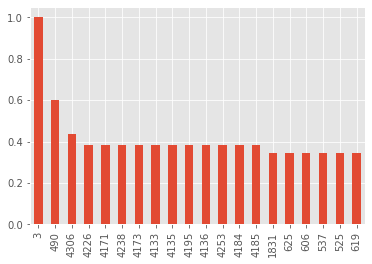

In [61]:
pd.DataFrame(arr).loc[3].sort_values(ascending = False).head(20).plot(kind = 'bar')

In [62]:
Tweets['text'].loc[3]

'Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμβόλιο από την Ουρουγουάη επειδή το δικαστήριο απαίτησε να μάθει το πε…  '

In [63]:
Tweets['text'].loc[900]

'Μου το στείλανε στο FB ... Άγρια επίθεση στον #Αδωνι μετά της συζύγου του στις 12 Απριλίου σε κεντρικό Ζαχαροπλαστε…  '

# Emolex Νέα_Δημοκρατία

In [64]:
filepath = "https://raw.githubusercontent.com/datajour-gr/Data_journalism/master/week10/NRC_GREEK_Translated_6_2020.csv"
emolex_df = pd.read_csv(filepath)
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [65]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13166,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13167,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13168,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13169,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13170,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [66]:
emolex_df = emolex_df.drop_duplicates(subset=['word'])
emolex_df = emolex_df.dropna()
emolex_df.reset_index(drop = True, inplace = True)

In [67]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13157,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13158,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13159,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13160,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [68]:
import spacy
nlp = spacy.load('el_core_news_sm')

In [69]:
#nea_tweets_df = pd.read_csv("/content/gdrive/My Drive/Colab Notebooks/Νέα_Δημοκρατία_tweet.tsv", sep='\t')

In [70]:
len(Tweets)
Tweets

,date,text,year,month,day,text_no_stopwords,clean_text_no_stopwords
0,Sun Jul 10 12:16:06 +0000 2022,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...,2022,7,10,RT @HatredHunter: Το επικοινωνιακό επιτελείο #...,RT @HatredHunter Το επικοινωνιακό επιτελείο #Σ...
1,Sun Jul 10 12:14:11 +0000 2022,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,2022,7,10,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,RT @JaneAusten1823 @Pierrakakis @MinDigitalGr ...
2,Sun Jul 10 12:11:55 +0000 2022,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...",2022,7,10,"Αυτο site ειναι parody;;; Αν οχι, εχει ολα φον...",Αυτο site ειναι parody;;; Αν οχι εχει ολα φοντ...
3,Sun Jul 10 11:58:37 +0000 2022,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...,2022,7,10,Προκαλεί Pfizer: Προτίμησε αποσύρει εμβόλιο Ου...,Προκαλεί Pfizer Προτίμησε αποσύρει εμβόλιο Ουρ...
4,Sun Jul 10 11:49:56 +0000 2022,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ...",2022,7,10,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 #κυβερ...","RT @Zoapotomisthom1 ""… Στην ΕΛΛΑΔΑ 20 #κυβερνη..."
...,...,...,...,...,...,...,...
4995,Thu Jun 30 14:39:06 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30,RT @JSarakiotis: Οι πολίτες επιδοτούν αισχροκέ...,RT @JSarakiotis Οι πολίτες επιδοτούν αισχροκέρ...
4996,Thu Jun 30 14:36:18 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30,RT @JSarakiotis: Οι πολίτες επιδοτούν αισχροκέ...,RT @JSarakiotis Οι πολίτες επιδοτούν αισχροκέρ...
4997,Thu Jun 30 14:36:07 +0000 2022,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...,2022,6,30,RT @JSarakiotis: Θα καταλήξουμε δικαστικές απο...,RT @JSarakiotis Θα καταλήξουμε δικαστικές αποφ...
4998,Thu Jun 30 14:34:13 +0000 2022,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...,2022,6,30,RT @ganavalo: Σε περίπτωση είδατε καταναλωτική...,RT @ganavalo Σε περίπτωση είδατε καταναλωτική ...


In [71]:
#short_tweets_nea = Tweets[['created_at','full_text' ]]
#short_tweets_nea = short_tweets_syr.rename(columns={'created_at': 'date', 'full_text': 'text'} )

In [72]:
short_tweets_nea = Tweets[['date','text' ]]

short_tweets_nea

,date,text
0,Sun Jul 10 12:16:06 +0000 2022,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...
1,Sun Jul 10 12:14:11 +0000 2022,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...
2,Sun Jul 10 12:11:55 +0000 2022,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα..."
3,Sun Jul 10 11:58:37 +0000 2022,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...
4,Sun Jul 10 11:49:56 +0000 2022,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ..."
...,...,...
4995,Thu Jun 30 14:39:06 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4996,Thu Jun 30 14:36:18 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4997,Thu Jun 30 14:36:07 +0000 2022,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...
4998,Thu Jun 30 14:34:13 +0000 2022,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...


In [73]:
short_tweets_nea.tail()

,date,text
4995,Thu Jun 30 14:39:06 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4996,Thu Jun 30 14:36:18 +0000 2022,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...
4997,Thu Jun 30 14:36:07 +0000 2022,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...
4998,Thu Jun 30 14:34:13 +0000 2022,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...
4999,Thu Jun 30 14:33:40 +0000 2022,RT @jWk5pCNPf6Mt28J: Ο άλλος διχοτομησε το Αιγ...


In [74]:
short_tweets_nea.dtypes

date    object
text    object
dtype: object

In [75]:
short_tweets_nea['date'] = pd.to_datetime(short_tweets_nea['date'], format='%a %b %d %H:%M:%S +0000 %Y')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [76]:
short_tweets_nea['year'] = pd.DatetimeIndex(short_tweets_nea['date']).year
short_tweets_nea['month'] = pd.DatetimeIndex(short_tweets_nea['date']).month
short_tweets_nea['day'] = pd.DatetimeIndex(short_tweets_nea['date']).day
short_tweets_nea

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documen

,date,text,year,month,day
0,2022-07-10 12:16:06,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...,2022,7,10
1,2022-07-10 12:14:11,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,2022,7,10
2,2022-07-10 12:11:55,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...",2022,7,10
3,2022-07-10 11:58:37,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...,2022,7,10
4,2022-07-10 11:49:56,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ...",2022,7,10
...,...,...,...,...,...
4995,2022-06-30 14:39:06,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30
4996,2022-06-30 14:36:18,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30
4997,2022-06-30 14:36:07,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...,2022,6,30
4998,2022-06-30 14:34:13,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...,2022,6,30


In [77]:
short_tweets_nea.dtypes

date     datetime64[ns]
text             object
year              int64
month             int64
day               int64
dtype: object

In [78]:
emolex_df['word'].head(3)

0              αφεση
1    ενορκη βεβαιωση
2            εχοντας
Name: word, dtype: object

In [79]:
short_tweets_nea['text'] = short_tweets_nea['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [80]:
short_tweets_nea.head()

,date,text,year,month,day
0,2022-07-10 12:16:06,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...,2022,7,10
1,2022-07-10 12:14:11,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,2022,7,10
2,2022-07-10 12:11:55,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...",2022,7,10
3,2022-07-10 11:58:37,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...,2022,7,10
4,2022-07-10 11:49:56,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ...",2022,7,10


In [81]:
vec = CountVectorizer(analyzer = 'word', vocabulary = emolex_df.word, 
                      strip_accents = 'unicode',  
                      stop_words= nlp.Defaults.stop_words,
                      ngram_range=(1, 2))

In [82]:
#from sklearn.feature_extraction.text import TfidfVectorizer
#CountVectorizer(stop_words='english', binary=True)
# Θέλω να ελέγξω μόνο τις λέξεις που υπάρχουν στο συναισθηματικό λεξικό

#CountVectorizer(analyzer = 'word', 
#              strip_accents = 'unicode', 
#               token_pattern='[Α-Ωα-ωΆ-Ώά-ώ]{2,}', 
#               stop_words= lc_stop_words_df['stop_w'].tolist())


matrix = vec.fit_transform(short_tweets_nea['text'])
vocab = vec.get_feature_names()
wordcount_df = pd.DataFrame(matrix.toarray(), columns=vocab)
wordcount_df.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['αδιακοπα', 'ακομα', 'ακομη', 'ακριβως', 'αλλα', 'αλλαχου', 'αλλες', 'αλλη', 'αλλην', 'αλλης', 'αλλιως', 'αλλιωτικα', 'αλλο', 'αλλοι', 'αλλοιως', 'αλλοιωτικα', 'αλλον', 'αλλος', 'αλλοτε', 'αλλου', 'αλλους', 'αλλων', 'αμα', 'αμεσα', 'αμεσως', 'ανα', 'αναμεσα', 'αναμεταξυ', 'ανευ', 'αντι', 'αντιπερα', 'αντις', 'ανω', 'ανωτερω', 'αξαφνα', 'απεναντι', 'απο', 'αποψε', 'αρα', 'αραγε', 'αρκετα', 'αρκετες', 'αρχικα', 'αυριο', 'αυτα', 'αυτες', 'αυτη', 'αυτην', 'αυτης', 'αυτο', 'αυτοι', 'αυτον', 'αυτος', 'αυτου', 'αυτους', 'αυτων', 'αφοτου', 'αφου', 'βεβαια

,αφεση,ενορκη βεβαιωση,εχοντας,εχω,οριο,ορμος,υδρα,αγια τραπεζα,αμην,απατσι,...,κλητηριο ενταλμα,κατειργασμενος,μαγια,κιτρινο,κιτρινιζω,ουρλιασμα,κροκος αυγου,νεοτερος,ζεφυρος,ζουμ
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [83]:
wordcount_df.shape

(5000, 13161)

In [84]:
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [85]:
emolex_df[emolex_df.Anger == 1].tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13094,διεξοδος,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13096,ζωυφια,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
13100,θυματοποιω,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0
13128,αποτυχημενος,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [86]:
# Φτιάξε μια λίστα με positive words

angry_words = emolex_df[emolex_df.Anger == 1]['word']

positive_words = emolex_df[emolex_df.Positive == 1]['word']


# Φτιάξε μια λίστα με sadness words
sadness_words = emolex_df[emolex_df.Sadness == 1]['word']


# Φτιάξε μια λίστα με surprise words
surprise_words = emolex_df[emolex_df.Surprise == 1]['word']


# Φτιάξε μια λίστα με disgust words
disgust_words = emolex_df[emolex_df.Disgust == 1]['word']


# Φτιάξε μια λίστα με anticipation words
anticipation_words = emolex_df[emolex_df.Anticipation == 1]['word']


# Φτιάξε μια λίστα με negative words
negative_words = emolex_df[emolex_df.Negative == 1]['word']



# Φτιάξε μια λίστα με joy words
joy_words = emolex_df[emolex_df.Joy == 1]['word']


# Φτιάξε μια λίστα με trust words
trust_words = emolex_df[emolex_df.Trust == 1]['word']



# Φτιάξε μια λίστα με fear words
fear_words = emolex_df[emolex_df.Fear == 1]['word']


In [87]:
short_tweets_nea.head(3)

,date,text,year,month,day
0,2022-07-10 12:16:06,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...,2022,7,10
1,2022-07-10 12:14:11,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,2022,7,10
2,2022-07-10 12:11:55,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...",2022,7,10


In [88]:
short_tweets_nea['anger'] = wordcount_df[angry_words].sum(axis=1)

short_tweets_nea['positivity'] = wordcount_df[positive_words].sum(axis=1)


short_tweets_nea['joy'] = wordcount_df[joy_words].sum(axis=1)


short_tweets_nea['disgust'] = wordcount_df[disgust_words].sum(axis=1)


short_tweets_nea['surprise'] = wordcount_df[surprise_words].sum(axis=1)

short_tweets_nea['trust'] = wordcount_df[trust_words].sum(axis=1)


short_tweets_nea['anticipation'] = wordcount_df[anticipation_words].sum(axis=1)


short_tweets_nea['sadness'] = wordcount_df[sadness_words].sum(axis=1)

short_tweets_nea['negative'] = wordcount_df[negative_words].sum(axis=1)

short_tweets_nea['fear'] = wordcount_df[fear_words].sum(axis=1)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [89]:
short_tweets_nea

,date,text,year,month,day,anger,positivity,joy,disgust,surprise,trust,anticipation,sadness,negative,fear
0,2022-07-10 12:16:06,RT @HatredHunter: Το επικοινωνιακό επιτελείο τ...,2022,7,10,0,1,1,0,1,1,1,0,0,0
1,2022-07-10 12:14:11,RT @JaneAusten1823: @Pierrakakis @MinDigitalGr...,2022,7,10,0,0,0,0,0,0,0,0,0,0
2,2022-07-10 12:11:55,"Αυτο το site ειναι parody;;;\nΑν οχι, εχει ολα...",2022,7,10,0,0,0,1,0,0,0,0,0,0
3,2022-07-10 11:58:37,Προκαλεί η Pfizer: Προτίμησε να αποσύρει το εμ...,2022,7,10,1,1,0,1,0,1,1,0,1,1
4,2022-07-10 11:49:56,"RT @Zoapotomisthom1: ""… Στην ΕΛΛΑΔΑ 2.0 η #κυβ...",2022,7,10,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,2022-06-30 14:39:06,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30,0,0,0,0,0,0,0,0,0,0
4996,2022-06-30 14:36:18,RT @JSarakiotis: Οι πολίτες επιδοτούν την αισχ...,2022,6,30,0,0,0,0,0,0,0,0,0,0
4997,2022-06-30 14:36:07,RT @JSarakiotis: Θα καταλήξουμε σε δικαστικές ...,2022,6,30,0,1,1,0,0,1,1,0,0,0
4998,2022-06-30 14:34:13,RT @ganavalo: Σε περίπτωση που δεν είδατε πως ...,2022,6,30,0,0,0,0,0,1,0,0,1,1


In [90]:
max = 0
happiest_tweet = ""
for i in range(0,len(short_tweets_nea)):
  #print(short_tweets_Rus.iloc[i]['positivity'])
  if short_tweets_nea.iloc[i]['positivity'] > max:
    happiest_tweet = short_tweets_nea.iloc[i]['text']
    max = short_tweets_nea.iloc[i]['positivity']


happiest_tweet

'RT @skopimios: Συγνώμη ζητάνε Άνδρες που διαθέτουν ενσυναίσθηση .. \nΚαι ενσυναίσθηση διαθέτουν οι Επιφανής Άνδρες..! \n#Μητσοτακης \n#κυβερνη…'

In [91]:
max = 0
negative_tweet = ""
for i in range(0,len(short_tweets_nea)):
  #print(short_tweets_nea.iloc[i]['positivity'])
  if short_tweets_nea.iloc[i]['negative'] > max:
    negative_tweet = short_tweets_nea.iloc[i]['text']
    max = short_tweets_nea.iloc[i]['negative']


negative_tweet

'3 χρονια ακροδεξιά κυβέρνηση Μητσοτακη\nΘανατικό, καταστροφή, εμπλοκή σε πολέμους, χρεωκοπία, η μαζικη φτωχεια ως κε…  '

In [92]:
max = 0
saddest_tweet = ""
for i in range(0,len(short_tweets_nea)):
  #print(short_tweets_nea.iloc[i]['positivity'])
  if short_tweets_nea.iloc[i]['sadness'] > max:
    saddest_tweet = short_tweets_nea.iloc[i]['text']
    max = short_tweets_nea.iloc[i]['sadness']

saddest_tweet

'3 χρονια ακροδεξιά κυβέρνηση Μητσοτακη\nΘανατικό, καταστροφή, εμπλοκή σε πολέμους, χρεωκοπία, η μαζικη φτωχεια ως κε…  '

In [93]:
max = 0
fear_tweet = ""
for i in range(0,len(short_tweets_nea)):
  #print(short_tweets_nea.iloc[i]['positivity'])
  if short_tweets_nea.iloc[i]['fear'] > max:
    fear_tweet = short_tweets_nea.iloc[i]['text']
    max = short_tweets_nea.iloc[i]['fear']

fear_tweet

'3 χρονια ακροδεξιά κυβέρνηση Μητσοτακη\nΘανατικό, καταστροφή, εμπλοκή σε πολέμους, χρεωκοπία, η μαζικη φτωχεια ως κε…  '

In [94]:
max = 0
trust_tweet = ""
for i in range(0,len(short_tweets_nea)):
  #print(short_tweets_nea.iloc[i]['positivity'])
  if short_tweets_nea.iloc[i]['trust'] > max:
    trust_tweet = short_tweets_nea.iloc[i]['text']
    max = short_tweets_nea.iloc[i]['trust']

trust_tweet

'RT @Ftinogravatas: Σας λείπει λίγο, ο φιλόσοφος Στέλιος Ράμφος; \nΘέλω να ακούσω ότι είναι ευλογία οι αυξήσεις στο #ρεύμα , ευλογία η τιμή σ…'

In [95]:
short_tweets_nea.set_index('date' , inplace=True)

In [96]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')

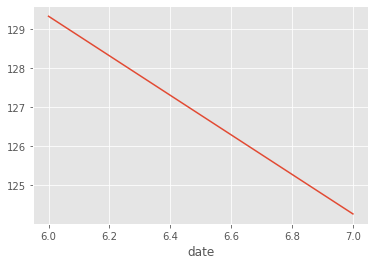

In [97]:
short_tweets_nea['text'].str.len().groupby(by=short_tweets_nea.index.month).mean().plot()

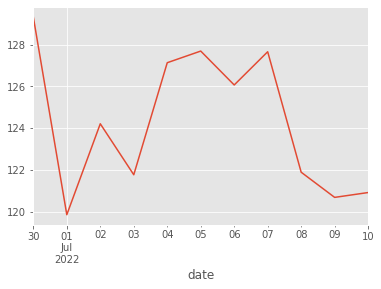

In [98]:
short_tweets_nea['text'].str.len().resample('D').mean().plot() 

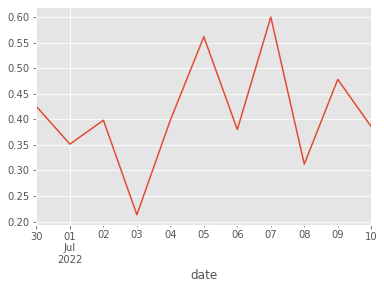

In [99]:
short_tweets_nea['positivity'].resample('D').mean().plot() 

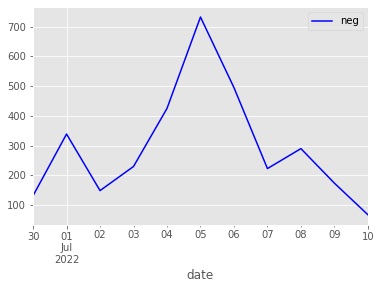

In [100]:
short_tweets_nea['negative'].resample('D').sum().plot(color = 'b',label = 'neg').legend() 

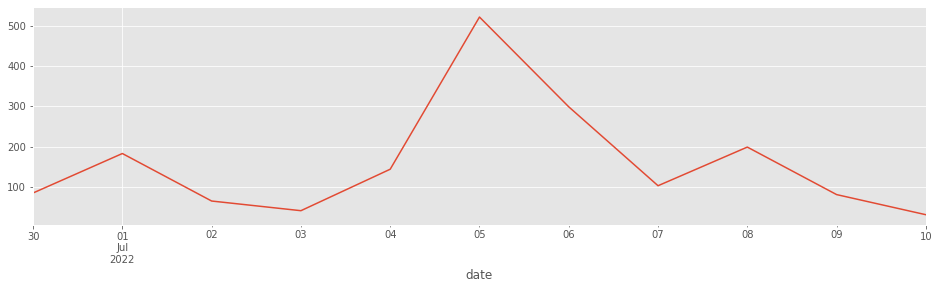

In [101]:
short_tweets_nea['anger'].resample('D').sum().plot(figsize=(16,4))

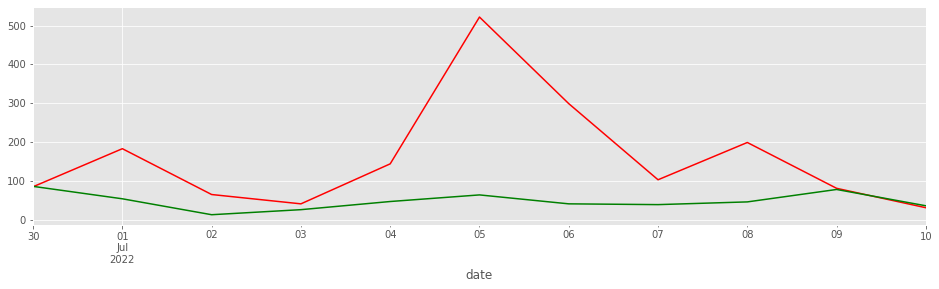

In [102]:
ax = short_tweets_nea['anger'].resample('D').sum().plot(figsize=(16,4), color = 'red')
short_tweets_nea['joy'].resample('D').sum().plot(figsize=(16,4), ax = ax, color = 'green')

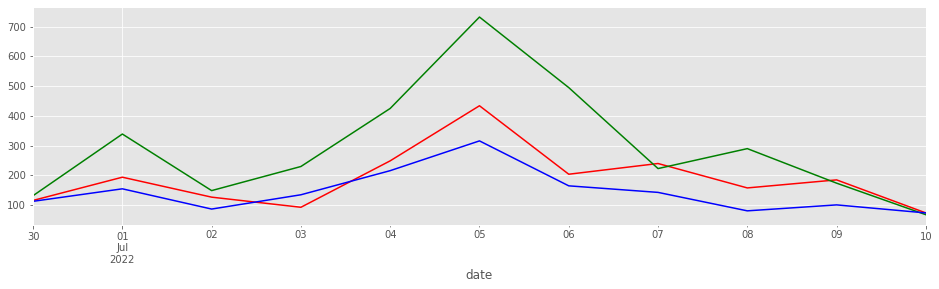

In [103]:
ax = short_tweets_nea['positivity'].resample('D').sum().plot(figsize=(16,4), color = 'red')
short_tweets_nea['negative'].resample('D').sum().plot(figsize=(16,4), ax = ax, color = 'green')
short_tweets_nea['trust'].resample('D').sum().plot(figsize=(16,4), ax = ax, color = 'blue')

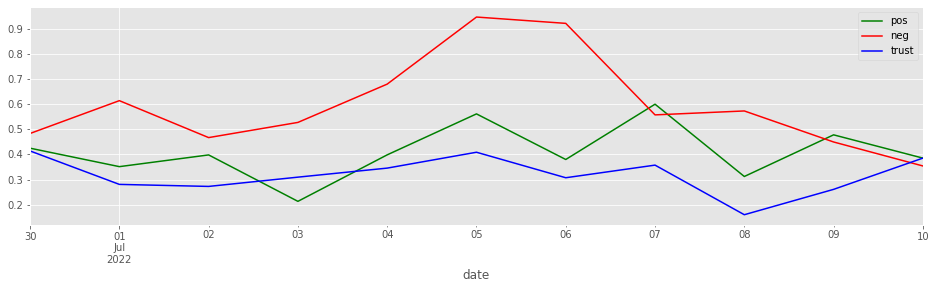

In [104]:
ax = short_tweets_nea['positivity'].resample('D').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_nea['negative'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_nea['trust'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

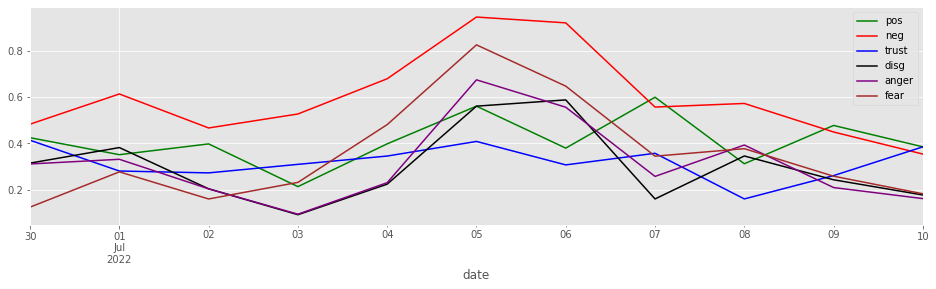

In [105]:
plt.style.use('ggplot')
ax = short_tweets_nea['positivity'].resample('D').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_nea['negative'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_nea['trust'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

short_tweets_nea['disgust'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'disg',color = 'black').legend() 

short_tweets_nea['anger'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'anger',color = 'purple').legend() 

short_tweets_nea['fear'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'fear',color = 'brown').legend()    

Text(0, 0.5, 'Years')

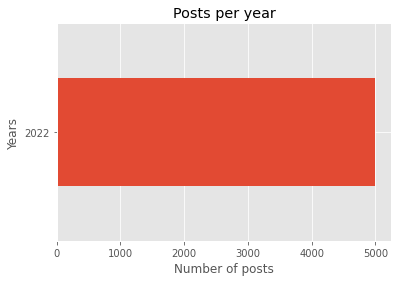

In [106]:
short_tweets_nea['text'].groupby(by=short_tweets_nea.index.year).count().plot(kind='barh')
plt.title("Posts per year")
plt.xlabel("Number of posts")
plt.ylabel("Years")

Text(0, 0.5, 'Month of the year')

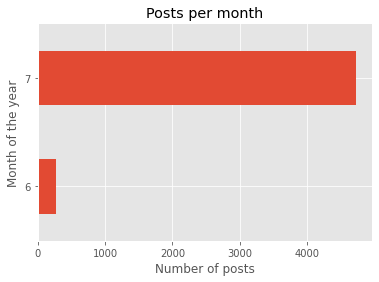

In [107]:
short_tweets_nea['text'].groupby(by=short_tweets_nea.index.month).count().plot(kind='barh')
plt.title("Posts per month")
plt.xlabel("Number of posts")
plt.ylabel("Month of the year")

Text(0, 0.5, 'Hour of the day')

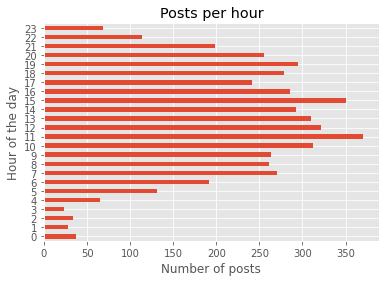

In [108]:
short_tweets_nea['text'].groupby(by=short_tweets_nea.index.hour).count().plot(kind='barh')
plt.title("Posts per hour")
plt.xlabel("Number of posts")
plt.ylabel("Hour of the day")

#  #Συριζα

In [109]:
tweets = []
MAX_ATTEMPTS = 50
COUNT_OF_TWEETS_TO_BE_FETCHED = 10000 

for i in range(0,MAX_ATTEMPTS):

    if(COUNT_OF_TWEETS_TO_BE_FETCHED < len(tweets)):
        print("We Got ", len(tweets), " tweets!!!")
        break # we got the  tweets... !!

    #----------------------------------------------------------------#
    # STEP 1: Query Twitter
    # STEP 2: Save the returned tweets
    # STEP 3: Get the next max_id
    #----------------------------------------------------------------#

    # STEP 1: Query Twitter
    if(0 == i):
        # Query twitter for data. 
        results = twitter.search(q="Συριζα",count='100')
        print("I Got:", len(results['statuses']), " tweets")
    else:
        # After the first call we should have max_id from result of previous call. Pass it in query.
        results = twitter.search(q="Συριζα",count='100', include_entities='true',max_id=next_max_id)
        print("I Got:", len(results['statuses']), " tweets")


    # STEP 2: Save the returned tweets
    for result in results['statuses']:
#        tweet_text = result['text']
        tweets.append(result)


    # STEP 3: Get the next max_id
    try:
        # Parse the data returned to get max_id to be passed in consequent call.
        next_results_url_params = results['search_metadata']['next_results']
        next_max_id = next_results_url_params.split('max_id=')[1].split('&')[0]
    except:
        # No more next pages
        break

I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 79  tweets
I Got: 100  tweets
I Got: 79  tweets
I Got: 89  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 99  tweets
I Got: 100  tweets
I Got: 95  tweets
I Got: 97  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets
I Got: 100  tweets


In [110]:
#results['search_metadata']

In [111]:
#results['statuses']

In [112]:
syr_df = pd.DataFrame(tweets)
syr_df

,created_at,id,id_str,text,truncated,entities,metadata,source,in_reply_to_status_id,in_reply_to_status_id_str,...,retweet_count,favorite_count,favorited,retweeted,lang,extended_entities,possibly_sensitive,quoted_status_id,quoted_status_id_str,quoted_status
0,Sun Jul 10 12:29:47 +0000 2022,1546109425626275840,1546109425626275840,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...,False,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/iphone"" r...",NaN,None,...,142,0,False,False,el,NaN,NaN,NaN,NaN,NaN
1,Sun Jul 10 12:29:34 +0000 2022,1546109373335887876,1546109373335887876,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,False,"{'hashtags': [{'text': 'Μιχαηλίδης', 'indices'...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,24,0,False,False,el,"{'media': [{'id': 1546083428583497731, 'id_str...",False,NaN,NaN,NaN
2,Sun Jul 10 12:29:05 +0000 2022,1546109249910177792,1546109249910177792,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...,True,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""https://dlvrit.com/"" rel=""nofollow"">d...",NaN,None,...,0,0,False,False,el,NaN,False,NaN,NaN,NaN
3,Sun Jul 10 12:29:01 +0000 2022,1546109234332553216,1546109234332553216,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...,False,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,4,0,False,False,el,NaN,NaN,NaN,NaN,NaN
4,Sun Jul 10 12:28:58 +0000 2022,1546109224031322113,1546109224031322113,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...,False,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",1.546067e+18,1546067027860791297,...,0,0,False,False,el,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4933,Sat Jul 09 13:17:51 +0000 2022,1545759136088051713,1545759136088051713,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...,False,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""https://mobile.twitter.com"" rel=""nofo...",NaN,None,...,119,0,False,False,el,NaN,NaN,NaN,NaN,NaN
4934,Sat Jul 09 13:17:37 +0000 2022,1545759078953226240,1545759078953226240,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...,True,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",1.545756e+18,1545756352781459457,...,0,1,False,False,el,NaN,NaN,NaN,NaN,NaN
4935,Sat Jul 09 13:17:31 +0000 2022,1545759051593793536,1545759051593793536,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ...",False,"{'hashtags': [{'text': 'Αντώναρος', 'indices':...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,46,0,False,False,el,NaN,NaN,NaN,NaN,NaN
4936,Sat Jul 09 13:17:16 +0000 2022,1545758987487936512,1545758987487936512,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ...",False,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'el', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,27,0,False,False,el,NaN,NaN,NaN,NaN,NaN


In [113]:
# Number of tweets the user has made
print("I got :", len(syr_df), " in total!!!")

I got : 4938  in total!!!


In [114]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [115]:
syr_df.to_csv("/content/gdrive/My Drive/Colab Notebooks/syriza_tweet.tsv", sep='\t')

# Νέα ενότητα #Συριζα

In [116]:
syr_df =pd.read_csv("/content/gdrive/My Drive/Colab Notebooks/syriza_tweet.tsv", sep='\t')

In [117]:
syr = syr_df[['created_at','text' ]]
syr = syr.rename(columns={'created_at': 'date'} )
syr

,date,text
0,Sun Jul 10 12:29:47 +0000 2022,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...
1,Sun Jul 10 12:29:34 +0000 2022,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...
2,Sun Jul 10 12:29:05 +0000 2022,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...
3,Sun Jul 10 12:29:01 +0000 2022,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...
4,Sun Jul 10 12:28:58 +0000 2022,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...
...,...,...
4933,Sat Jul 09 13:17:51 +0000 2022,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...
4934,Sat Jul 09 13:17:37 +0000 2022,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...
4935,Sat Jul 09 13:17:31 +0000 2022,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ..."
4936,Sat Jul 09 13:17:16 +0000 2022,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ..."


In [118]:
#syr.dtypes

In [119]:
syr['year'] = pd.DatetimeIndex(syr['date']).year
syr['month'] = pd.DatetimeIndex(syr['date']).month
syr['day'] = pd.DatetimeIndex(syr['date']).day
syr

,date,text,year,month,day
0,Sun Jul 10 12:29:47 +0000 2022,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...,2022,7,10
1,Sun Jul 10 12:29:34 +0000 2022,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,2022,7,10
2,Sun Jul 10 12:29:05 +0000 2022,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...,2022,7,10
3,Sun Jul 10 12:29:01 +0000 2022,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...,2022,7,10
4,Sun Jul 10 12:28:58 +0000 2022,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...,2022,7,10
...,...,...,...,...,...
4933,Sat Jul 09 13:17:51 +0000 2022,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...,2022,7,9
4934,Sat Jul 09 13:17:37 +0000 2022,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...,2022,7,9
4935,Sat Jul 09 13:17:31 +0000 2022,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ...",2022,7,9
4936,Sat Jul 09 13:17:16 +0000 2022,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ...",2022,7,9


In [120]:
syr['text'] = syr['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.


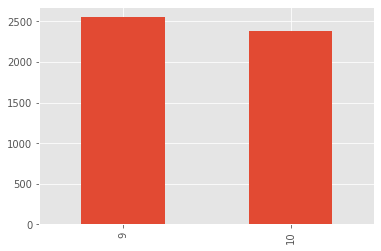

In [121]:
syr['day'].value_counts().plot(kind='bar')

In [122]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

In [123]:
syr[syr['year']==2022]['text']

0       RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...
1       RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...
2       ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...
3       RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...
4       @klitirinoumaria @CZachariadis @syriza_gr Μαυρ...
                              ...                        
4933    RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...
4934    @bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...
4935    RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ...
4936    RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ...
4937    RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...
Name: text, Length: 4938, dtype: object

In [124]:
# Ισως καποτε χρειαστεί να αφαιρέσουμε τους τόνους.....
text = syr['text'].str.replace('ά','α').str.replace("έ", "ε").str.replace('ή','η').str.replace('ί','ι').str.replace('ό','ο').str.replace('ύ','υ').str.replace('ώ','ω')

In [125]:
text = syr[syr['year']==2022]['text'].str.cat(sep = '.').replace("amp", ' ')
text

'RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπουλο να δίνει τον δικό του αγώνα για την Ελευθερία του Τύπου στην Ελλάδα επί ΣΥΡΙΖΑ.  .RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας και όλοι οι άλλοι ποινικοί γιατί ο #ΣΥΡΙΖΑ είναι με τον άνθρωπο.  .ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί στο ειδικό δικαστήριο – Κόντρα για την ελευθερία του Τύπου…  .RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπίνει αμάσητο Κορκονέα και  Καλαμπόκα που κυκλοφορούν ελεύθεροι, χρεώνει στο ΣΥΡΙΖΑ Κουφοντίνα….@klitirinoumaria @CZachariadis @syriza_gr Μαυρίστε ΣΥΡΙΖΑ, θα σας διορίσει η ΝΔ όταν γίνει κυβέρνηση....RT @AntonieSyn: @MChristakea @SurizaX Πληθωρισμός Σρι Λάνκα 54%. Ότι θα είχαμε πάθει με Σύριζα ίσως και χειρότερα..RT @Syther_Q: Αν γινόταν στην Ελλάδα αυτό που έγινε στη #Σρι_Λανκα, όλος ο κόσμος θα μπούκαρε στη Βουλή και το Μαξίμου και το ΚΚΕ θα ήταν μ….RT @theFAQgr: Η ΝΔ καλά θα κάνει να το βουλώνει, γιατί το "πρώτο ιδιωτικό κανάλι στη χώρα" (MEGA) δεν το έκλεισε ο ΣΥΡΙΖΑ to 15, αλλά: οι μ….RT @

In [126]:
list(STOPWORDS)[0:20]

["there's",
 'since',
 "who's",
 "i'm",
 'this',
 'however',
 'again',
 'under',
 "you'll",
 'does',
 "haven't",
 'are',
 'itself',
 "couldn't",
 'theirs',
 'myself',
 'my',
 "that's",
 "he's",
 'was']

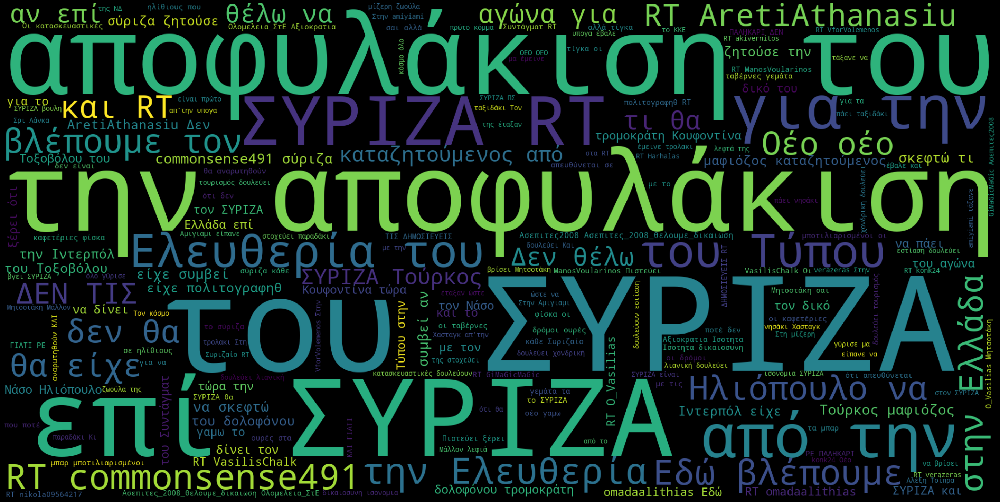

In [127]:
wordcloud = WordCloud(
#   stopwords = STOPWORDS,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [128]:
import spacy
!python -m spacy download el_core_news_sm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.6 MB 4.0 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('el_core_news_sm')


In [129]:
nlp = spacy.load('el_core_news_sm')
list(nlp.Defaults.stop_words)[0:20]

['της',
 'τούτης',
 'όλο',
 'αι',
 'είχες',
 'εγώ',
 'ενός',
 'υπέρ',
 'κάμποσους',
 'πρωτύτερα',
 'εκείνους',
 'αν',
 'πόσης',
 'βεβαιότατα',
 'τόση',
 'λιγότερο',
 'να',
 'πέρυσι',
 'δι',
 'μεν']

In [130]:
text = syr['text'].str.cat(sep = '.').replace('.','').strip()
text = text.replace('amp','').strip()
text = text.replace('rt','').strip()
text = text.replace('\n','').strip()
text = text.replace(':','').strip()
text

'RT @omadaalithias Εδώ βλέπουμε τον Νάσο Ηλιόπουλο να δίνει τον δικό του αγώνα για την Ελευθερία του Τύπου στην Ελλάδα επί ΣΥΡΙΖΑ  RT @John_Fletcher70 #Μιχαηλίδης #Κουφοντινας και όλοι οι άλλοι ποινικοί γιατί ο #ΣΥΡΙΖΑ είναι με τον άνθρωπο  ΝΔ σε ΣΥΡΙΖΑ Ο υπουργός σας έχει παραπεμφθεί στο ειδικό δικαστήριο – Κόντρα για την ελευθερία του Τύπου…  RT @GVrynas Η ηλίθια βρώμικη Δεξιά που καταπίνει αμάσητο Κορκονέα και  Καλαμπόκα που κυκλοφορούν ελεύθεροι, χρεώνει στο ΣΥΡΙΖΑ Κουφοντίνα…@klitirinoumaria @CZachariadis @syriza_gr Μαυρίστε ΣΥΡΙΖΑ, θα σας διορίσει η ΝΔ όταν γίνει κυβέρνησηRT @AntonieSyn @MChristakea @SurizaX Πληθωρισμός Σρι Λάνκα 54% Ότι θα είχαμε πάθει με Σύριζα ίσως και χειρότεραRT @Syther_Q Αν γινόταν στην Ελλάδα αυτό που έγινε στη #Σρι_Λανκα, όλος ο κόσμος θα μπούκαρε στη Βουλή και το Μαξίμου και το ΚΚΕ θα ήταν μ…RT @theFAQgr Η ΝΔ καλά θα κάνει να το βουλώνει, γιατί το "πρώτο ιδιωτικό κανάλι στη χώρα" (MEGA) δεν το έκλεισε ο ΣΥΡΙΖΑ to 15, αλλά οι μ…RT @AretiAthanasiu Δεν θέλω

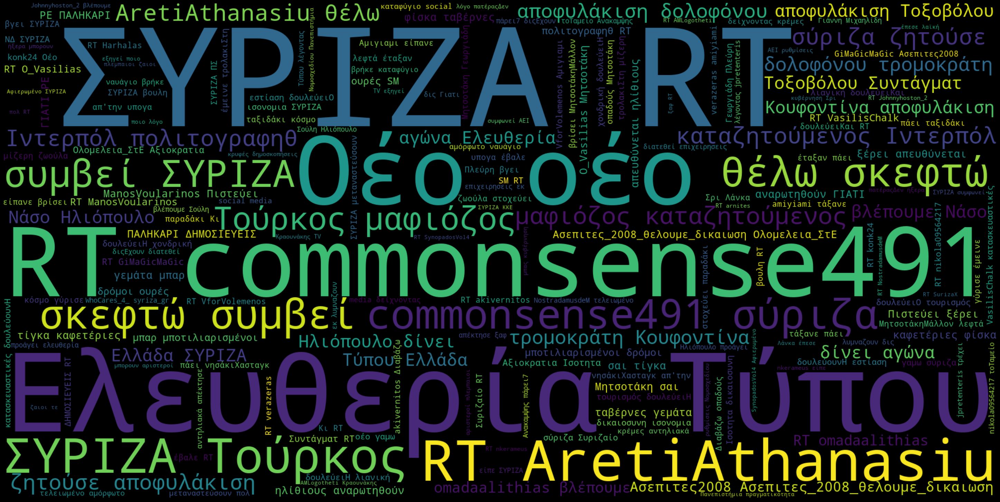

In [131]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [132]:
from PIL import Image
import numpy as np

In [133]:
doc = nlp(syr['text'][1])

In [134]:
for token in doc:
    print(token, token.lemma_)

RT RT
@John_Fletcher70 @John_Fletcher70
: :
# #
Μιχαηλίδης Μιχαηλίδης
# #
Κουφοντινας Κουφοντινα
και και
όλοι όλος
οι ο
άλλοι άλλος
ποινικοί ποινικός
γιατί γιατί
ο ο
# #
ΣΥΡΙΖΑ ΣΥΡΙΖΑ
είναι είμαι
με με
τον ο
άνθρωπο άνθρωπος
. .
   


In [135]:
' '.join(token.lemma_ for token in doc)
text

'RT @omadaalithias Εδώ βλέπουμε τον Νάσο Ηλιόπουλο να δίνει τον δικό του αγώνα για την Ελευθερία του Τύπου στην Ελλάδα επί ΣΥΡΙΖΑ  RT @John_Fletcher70 #Μιχαηλίδης #Κουφοντινας και όλοι οι άλλοι ποινικοί γιατί ο #ΣΥΡΙΖΑ είναι με τον άνθρωπο  ΝΔ σε ΣΥΡΙΖΑ Ο υπουργός σας έχει παραπεμφθεί στο ειδικό δικαστήριο – Κόντρα για την ελευθερία του Τύπου…  RT @GVrynas Η ηλίθια βρώμικη Δεξιά που καταπίνει αμάσητο Κορκονέα και  Καλαμπόκα που κυκλοφορούν ελεύθεροι, χρεώνει στο ΣΥΡΙΖΑ Κουφοντίνα…@klitirinoumaria @CZachariadis @syriza_gr Μαυρίστε ΣΥΡΙΖΑ, θα σας διορίσει η ΝΔ όταν γίνει κυβέρνησηRT @AntonieSyn @MChristakea @SurizaX Πληθωρισμός Σρι Λάνκα 54% Ότι θα είχαμε πάθει με Σύριζα ίσως και χειρότεραRT @Syther_Q Αν γινόταν στην Ελλάδα αυτό που έγινε στη #Σρι_Λανκα, όλος ο κόσμος θα μπούκαρε στη Βουλή και το Μαξίμου και το ΚΚΕ θα ήταν μ…RT @theFAQgr Η ΝΔ καλά θα κάνει να το βουλώνει, γιατί το "πρώτο ιδιωτικό κανάλι στη χώρα" (MEGA) δεν το έκλεισε ο ΣΥΡΙΖΑ to 15, αλλά οι μ…RT @AretiAthanasiu Δεν θέλω

In [136]:
full_doc = nlp(text)

In [137]:
clear_text = ' '.join(token.lemma_ for token in full_doc)
clear_text[200:400]

' # ΣΥΡΙΖΑ είμαι με ο άνθρωπος   ΝΔ σε ΣΥΡΙΖΑ ο υπουργός μου έχω παραπεμφθεί σε ο ειδικός δικαστήριο – κόντρα για ο ελευθερία ο τύπος …   RT @GVrynas ο ηλίθια βρώμικος δεξιά που καταπίνω αμάσητο Κορκον'

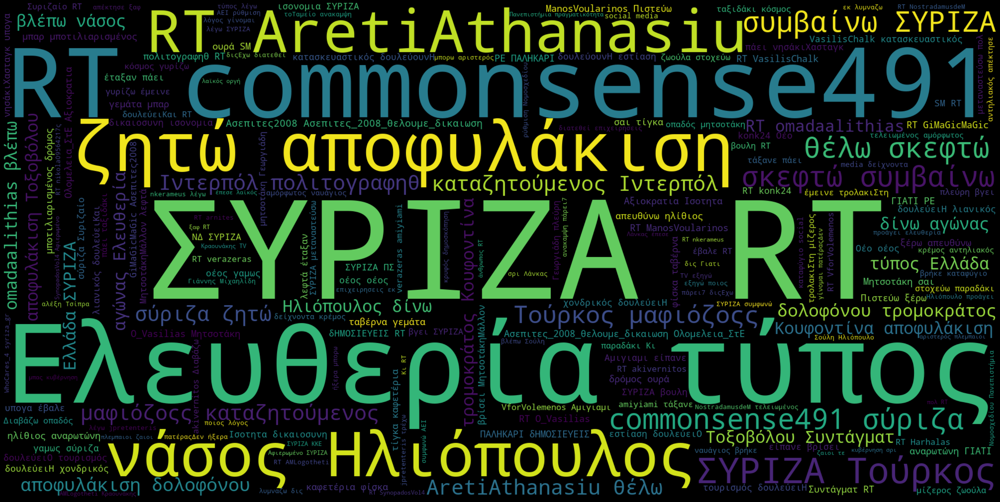

In [138]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(clear_text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [139]:
from collections import Counter
Counter(" ".join(Tweets["text"]).split()).most_common(16)

[('RT', 3801),
 ('το', 1725),
 ('#κυβερνηση_Μητσοτακη', 1698),
 ('να', 1457),
 ('και', 1293),
 ('η', 1156),
 ('ο', 1112),
 ('για', 1091),
 ('την', 1039),
 ('οι', 951),
 ('της', 902),
 ('από', 875),
 ('του', 779),
 ('σε', 755),
 ('που', 736),
 ('τα', 724)]

In [140]:
for word in nlp.Defaults.stop_words:
  print(word)
  break

της


In [141]:
syr['text_no_stopwords'] = syr['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words) and word != ':' and word != '\n' and word != "amp" and word != 'rt' and word != ',']))
syr['text_no_stopwords'] = syr['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words)]))
syr['clean_text_no_stopwords'] = syr['text']
#for stopword in nlp.Defaults.stop_words:
syr['clean_text_no_stopwords'] = syr['clean_text_no_stopwords'].apply(lambda x: ' '.join([word for word in x.split() if word not in nlp.Defaults.stop_words and word != "ή" and word != "ία" and word != "κι"]))
syr['clean_text_no_stopwords'] = syr['clean_text_no_stopwords'].apply(lambda x: x.replace("amp", "").strip())
syr['clean_text_no_stopwords'] = syr['clean_text_no_stopwords'].apply(lambda x: x.replace("rt", "").strip())
syr['clean_text_no_stopwords'] = syr['clean_text_no_stopwords'].apply(lambda x: x.replace(":", "").strip())
syr['clean_text_no_stopwords'] = syr['clean_text_no_stopwords'].apply(lambda x: x.replace(",", "").strip())
syr['clean_text_no_stopwords'] = syr['clean_text_no_stopwords'].apply(lambda x: x.replace("\n", "").strip())
syr['clean_text_no_stopwords'] = syr['clean_text_no_stopwords'].apply(lambda x: x.replace(".", "").strip())

In [142]:
freq = Counter(" ".join(syr["clean_text_no_stopwords"]).split()).most_common(16)
freq

[('RT', 3708),
 ('ΣΥΡΙΖΑ', 1475),
 ('Η', 673),
 ('Ο', 626),
 ('Δεν', 354),
 ('δουλεύει', 348),
 ('σύριζα', 338),
 ('αποφυλάκιση', 318),
 ('Ελλάδα', 261),
 ('κ', 259),
 ('Σύριζα', 257),
 ('Το', 245),
 ('ΝΔ', 241),
 ('#ΣΥΡΙΖΑ', 210),
 ('Οι', 208),
 ('Εδώ', 202)]

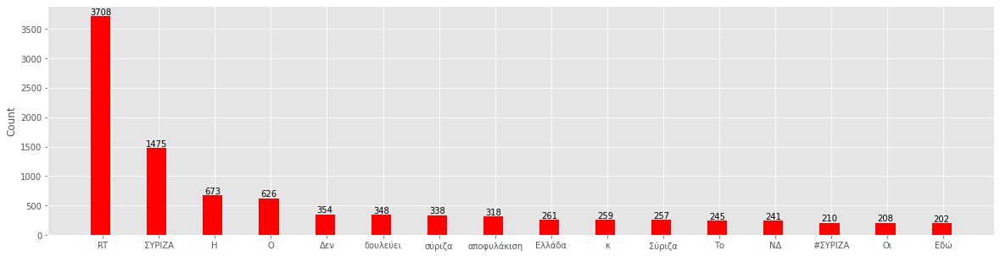

In [143]:
names, values = zip(*freq)
# names = [x[0] for x in data]  # These two lines are equivalent to the the zip-command.
# values = [x[1] for x in data] # These two lines are equivalent to the the zip-command.

ind = np.arange(len(freq))  # the x locations for the groups
width = 0.35       # the width of the bars

fig, ax = plt.subplots(figsize=(20,5))
rects1 = ax.bar(ind, values, width, color='r')
# add some text for labels, title and axes ticks
ax.set_ylabel('Count')
ax.set_xticks(ind+width/10.)
ax.set_xticklabels(names)

def autolabel(rects):
    # attach some text labels
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2, height,
                '%d' % int(height),
                ha='center', va='bottom')

autolabel(rects1)

plt.show()

# Vectorizing Συριζα

In [144]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer()

In [145]:
count_vector = cv.fit_transform(Tweets['text'])

In [146]:
count_vector.shape

(5000, 5820)

In [147]:
cv.get_feature_names()

results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,000,0_snarf_007,10,100,108,108η,1095,10άρα,10ωρο,11,...,ότι,όχι,όψει,ύβρις,ύπαρξη,ώρ,ώρα,ώρες,ώριμη,ώστε
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [148]:
#cv.vocabulary_

In [149]:
cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95)

In [150]:
count_vector = cv.fit_transform(syr['text'])

In [151]:
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,12,2015,2019,308,akivernitos,amiyiami,amlogotheti,amp,aretiathanasiu,arnites,...,τρομοκράτη,τσίπρα,τσίπρας,τσιπρας,τύπου,υπογα,φίσκα,χασταγκ,χονδρική,χώρα
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [152]:
from html import unescape
def my_tokenizer(doc):
            
    # apply the preprocessing and tokenzation steps
    doc_clean = unescape(doc).lower()
    tokens = nlp(doc_clean)
    lemmatized_tokens = [token.lemma_ for token in tokens if (len(str(token.lemma_))>2)]
            
    # use CountVectorizer's _word_ngrams built in method
    # to remove stop words and extract n-grams
    return(lemmatized_tokens)

In [153]:
 cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95, tokenizer=my_tokenizer)
 count_vector = cv.fit_transform(syr['text'])
 results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
 results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['έκασε ο', 'έτερα', 'έτερων', 'ήσω', 'ίσιος', 'αλλιώ', 'αλλιώτικος', 'αλλοιώ', 'αρκετός', 'γίνομαι', 'γρήγορο', 'διο', 'είχος', 'εαυτής', 'εαυτός', 'εκάστος', 'επόμενος', 'εσένος', 'ετέραις', 'ετού', 'ετούε ο', 'εχτής', 'ιδίο', 'κάνενς', 'κάνω', 'κανενό', 'λοιπός', 'μέλλω', 'μερικός', 'μπορώ', 'μόνας', 'ολωσδιόλος', 'ορισμένος', 'οριόμενσς', 'ποία', 'πολύς', 'προτός', 'προχτής', 'σε ο', 'ταύ', 'τουλάχισε ο', 'τρίτος', 'τός', 'χωριστό'] not in stop_words.
  % sorted(inconsistent)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,...,....,2015,308,@akivernitos,@amiyiami,@amlogotheti,@aretiathanasiu,@arnites,@commonsense491,...,τσίπρας,τσιπρα,τύπος,υπογα,φίσκα,φορά,χασταγκ,χονδρικός,χρόνος,χώρα
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [154]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(syr['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,amp,commonsense491,rt,αποφυλάκιση,βλέπουμε,δουλεύει,εκλογές,ελευθερία,ελλάδα,ηλιόπουλο,κυβέρνηση,μητσοτάκη,νδ,οέο,πάει,ρε,συριζα,συριζα_ξεφτιλες,σύριζα,τύπου
0,0,0,1,0,1,0,0,1,1,1,0,0,0,0,0,0,1,0,0,1
1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
2,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1
3,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
4,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0


In [155]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, token_pattern = '\\bσυρ[α-ωά-ώ]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(syr['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,συρ,συρίζα,συρι,συριζ,συριζα,συριζαίο,συριζαίοι,συριζαιο,συριζαιος,συριζαιων,συριζανελ,συριζαρα,συριζας,συριζαυγιτη,συριζοακριδες,συριζογιδι,συριζοτρολ,συριζόγυφτους
0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [156]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, ngram_range=(2, 2) ) #token_pattern = '\\bουκ[α-ωά-ώ]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(syr['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,amp αποφυλάκιση,commonsense491 σύριζα,rt aretiathanasiu,rt commonsense491,αποφυλάκιση δολοφόνου,αποφυλάκιση τοξοβόλου,δολοφόνου τρομοκράτη,ελευθερία τύπου,ζητούσε αποφυλάκιση,θέλω σκεφτώ,ιντερπόλ πολιτογραφηθ,καταζητούμενος ιντερπόλ,μαφιόζος καταζητούμενος,οέο οέο,σκεφτώ συμβεί,συμβεί συριζα,συριζα τούρκος,σύριζα ζητούσε,τούρκος μαφιόζος,τρομοκράτη κουφοντίνα
0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [157]:
results.sum(axis =0).sort_values(ascending = False)

ελευθερία τύπου            202
rt commonsense491          196
οέο οέο                    176
rt aretiathanasiu          166
συριζα τούρκος             146
commonsense491 σύριζα      146
σκεφτώ συμβεί              145
τούρκος μαφιόζος           145
συμβεί συριζα              145
θέλω σκεφτώ                145
καταζητούμενος ιντερπόλ    145
μαφιόζος καταζητούμενος    145
amp αποφυλάκιση            144
σύριζα ζητούσε             144
ιντερπόλ πολιτογραφηθ      144
ζητούσε αποφυλάκιση        144
δολοφόνου τρομοκράτη       144
αποφυλάκιση τοξοβόλου      144
αποφυλάκιση δολοφόνου      144
τρομοκράτη κουφοντίνα      144
dtype: int64

In [158]:
sum_words =  results.sum(axis =0)
sum_words.sort_values(ascending = False).head() 

ελευθερία τύπου      202
rt commonsense491    196
οέο οέο              176
rt aretiathanasiu    166
συριζα τούρκος       146
dtype: int64

In [159]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
 #                    token_pattern = '(\\bου[οω]ρ[οω]ν[α-ωά-ώ]+\\b') )\| (\\bμετ[α-ωά-ώ]\\b) #, tokenizer=my_tokenizer)
                     token_pattern = '\\bsyr[a-z0-9-_]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(syr['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,syriza_gr,syrizaep,syrizaglyfadas
0,0,0,0
1,0,0,0
2,0,0,0
3,0,0,0
4,1,0,0


In [160]:
results.sum(axis =0).sort_values(ascending = False)

syriza_gr         110
syrizaglyfadas     16
syrizaep            1
dtype: int64

In [161]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
                     vocabulary = ['Νεα Δημοκρατια', 'Συριζα', 'Εκλογες', 'Τουρκια']) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(syr['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,Νεα Δημοκρατια,Συριζα,Εκλογες,Τουρκια
0,0,0,0,0
1,0,0,0,0
2,0,0,0,0
3,0,0,0,0
4,0,0,0,0


In [162]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [163]:
tfidf_vectorizer = TfidfVectorizer(stop_words= nlp.Defaults.stop_words, max_features=500)
tfidf_matrix_train = tfidf_vectorizer.fit_transform(Tweets['text'])  #finds the tfidf score with normalization

In [164]:
results = pd.DataFrame(tfidf_matrix_train.toarray(), columns=tfidf_vectorizer.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,000,10,10ωρο,11,12,1998slang,1η,20,2008,2018,...,ψέματα,ψήφισε,ψηφιακή,ψηφιακη_καρτα,ψηφοφόροι,ωράριο,όπλα,όπλων,όρους,ώρα
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [165]:
from sklearn.metrics.pairwise import cosine_similarity

print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train[0:1], tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements

cosine scores ==>  [[1.         0.11678394 0.         ... 0.00900033 0.02819069 0.02874266]]


In [166]:
print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train, tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements

cosine scores ==>  [[1.         0.11678394 0.         ... 0.00900033 0.02819069 0.02874266]
 [0.11678394 1.         0.         ... 0.07706819 0.24139186 0.24611823]
 [0.         0.         1.         ... 0.         0.07513324 0.        ]
 ...
 [0.00900033 0.07706819 0.         ... 1.         0.01860363 0.01896789]
 [0.02819069 0.24139186 0.07513324 ... 0.01860363 1.         0.05941094]
 [0.02874266 0.24611823 0.         ... 0.01896789 0.05941094 1.        ]]


In [167]:
arr = cosine_similarity(tfidf_matrix_train, tfidf_matrix_train)

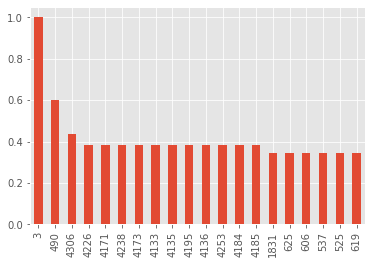

In [168]:
pd.DataFrame(arr).loc[3].sort_values(ascending = False).head(20).plot(kind = 'bar')

In [169]:
syr['text'].loc[3]

'RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπίνει αμάσητο Κορκονέα και  Καλαμπόκα που κυκλοφορούν ελεύθεροι, χρεώνει στο ΣΥΡΙΖΑ Κουφοντίνα…'

In [170]:
syr['text'].loc[900]

'RT @akrokentrwos_2: ΟΕΟ, ΟΕΟ, ΟΕΟ..\nΓΑΜΩ ΤΟ ΣΥΡΙΖΑ ΚΑΙ ΚΑΘΕ ΣΥΡΙΖΑΙΟ!!\nΦυσικά και καταδικάζω, εννοείται 😂😂\n\n '

# Emolex Συριζα

In [171]:
filepath = "https://raw.githubusercontent.com/datajour-gr/Data_journalism/master/week10/NRC_GREEK_Translated_6_2020.csv"
emolex_df = pd.read_csv(filepath)
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [172]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13166,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13167,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13168,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13169,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13170,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [173]:
emolex_df = emolex_df.drop_duplicates(subset=['word'])
emolex_df = emolex_df.dropna()
emolex_df.reset_index(drop = True, inplace = True)

In [174]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13157,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13158,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13159,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13160,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [175]:
import spacy
nlp = spacy.load('el_core_news_sm')

In [176]:
len(syr)
syr

,date,text,year,month,day,text_no_stopwords,clean_text_no_stopwords
0,Sun Jul 10 12:29:47 +0000 2022,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...,2022,7,10,RT @omadaalithias: Εδώ βλέπουμε Νάσο Ηλιόπουλο...,RT @omadaalithias Εδώ βλέπουμε Νάσο Ηλιόπουλο ...
1,Sun Jul 10 12:29:34 +0000 2022,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,2022,7,10,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,RT @John_Fletcher70 #Μιχαηλίδης #Κουφοντινας π...
2,Sun Jul 10 12:29:05 +0000 2022,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...,2022,7,10,ΝΔ ΣΥΡΙΖΑ: Ο υπουργός παραπεμφθεί ειδικό δικασ...,ΝΔ ΣΥΡΙΖΑ Ο υπουργός παραπεμφθεί ειδικό δικαστ...
3,Sun Jul 10 12:29:01 +0000 2022,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...,2022,7,10,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά καταπίνει ...,RT @GVrynas Η ηλίθια βρώμικη Δεξιά καταπίνει α...
4,Sun Jul 10 12:28:58 +0000 2022,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...,2022,7,10,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...
...,...,...,...,...,...,...,...
4933,Sat Jul 09 13:17:51 +0000 2022,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...,2022,7,9,"RT @akivernitos: Διαβάζω οπαδούς Μητσοτάκη, Γε...",RT @akivernitos Διαβάζω οπαδούς Μητσοτάκη Γεωρ...
4934,Sat Jul 09 13:17:37 +0000 2022,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...,2022,7,9,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...
4935,Sat Jul 09 13:17:31 +0000 2022,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ...",2022,7,9,"RT @GeorghyZhukov: Είχε, είχε, κόλλησε ΣΥΡΙΖΑ ...",RT @GeorghyZhukov Είχε είχε κόλλησε ΣΥΡΙΖΑ #Αν...
4936,Sat Jul 09 13:17:16 +0000 2022,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ...",2022,7,9,"RT @VasilisXtM: Το θάψιμο σκανδάλων, απόκρυψη ...",RT @VasilisXtM Το θάψιμο σκανδάλων απόκρυψη απ...


In [177]:
short_tweets_syr = syr[['date','text' ]]

short_tweets_syr

,date,text
0,Sun Jul 10 12:29:47 +0000 2022,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...
1,Sun Jul 10 12:29:34 +0000 2022,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...
2,Sun Jul 10 12:29:05 +0000 2022,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...
3,Sun Jul 10 12:29:01 +0000 2022,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...
4,Sun Jul 10 12:28:58 +0000 2022,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...
...,...,...
4933,Sat Jul 09 13:17:51 +0000 2022,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...
4934,Sat Jul 09 13:17:37 +0000 2022,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...
4935,Sat Jul 09 13:17:31 +0000 2022,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ..."
4936,Sat Jul 09 13:17:16 +0000 2022,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ..."


In [178]:
short_tweets_syr.tail()

,date,text
4933,Sat Jul 09 13:17:51 +0000 2022,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...
4934,Sat Jul 09 13:17:37 +0000 2022,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...
4935,Sat Jul 09 13:17:31 +0000 2022,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ..."
4936,Sat Jul 09 13:17:16 +0000 2022,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ..."
4937,Sat Jul 09 13:17:11 +0000 2022,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...


In [179]:
short_tweets_syr.dtypes

date    object
text    object
dtype: object

In [180]:
short_tweets_syr['date'] = pd.to_datetime(short_tweets_syr['date'], format='%a %b %d %H:%M:%S +0000 %Y')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [181]:
short_tweets_syr['year'] = pd.DatetimeIndex(short_tweets_syr['date']).year
short_tweets_syr['month'] = pd.DatetimeIndex(short_tweets_syr['date']).month
short_tweets_syr['day'] = pd.DatetimeIndex(short_tweets_syr['date']).day
short_tweets_syr

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documen

,date,text,year,month,day
0,2022-07-10 12:29:47,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...,2022,7,10
1,2022-07-10 12:29:34,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,2022,7,10
2,2022-07-10 12:29:05,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...,2022,7,10
3,2022-07-10 12:29:01,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...,2022,7,10
4,2022-07-10 12:28:58,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...,2022,7,10
...,...,...,...,...,...
4933,2022-07-09 13:17:51,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...,2022,7,9
4934,2022-07-09 13:17:37,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...,2022,7,9
4935,2022-07-09 13:17:31,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ...",2022,7,9
4936,2022-07-09 13:17:16,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ...",2022,7,9


In [182]:
short_tweets_syr.dtypes

date     datetime64[ns]
text             object
year              int64
month             int64
day               int64
dtype: object

In [183]:
emolex_df['word'].head(3)

0              αφεση
1    ενορκη βεβαιωση
2            εχοντας
Name: word, dtype: object

In [184]:
short_tweets_syr['text'] = short_tweets_syr['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [185]:
short_tweets_syr.head()

,date,text,year,month,day
0,2022-07-10 12:29:47,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...,2022,7,10
1,2022-07-10 12:29:34,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,2022,7,10
2,2022-07-10 12:29:05,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...,2022,7,10
3,2022-07-10 12:29:01,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...,2022,7,10
4,2022-07-10 12:28:58,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...,2022,7,10


In [186]:
vec = CountVectorizer(analyzer = 'word', vocabulary = emolex_df.word, 
                      strip_accents = 'unicode',  
                      stop_words= nlp.Defaults.stop_words,
                      ngram_range=(1, 2))

In [187]:
#from sklearn.feature_extraction.text import TfidfVectorizer
#CountVectorizer(stop_words='english', binary=True)
# Θέλω να ελέγξω μόνο τις λέξεις που υπάρχουν στο συναισθηματικό λεξικό

#CountVectorizer(analyzer = 'word', 
#              strip_accents = 'unicode', 
#               token_pattern='[Α-Ωα-ωΆ-Ώά-ώ]{2,}', 
#               stop_words= lc_stop_words_df['stop_w'].tolist())


matrix = vec.fit_transform(short_tweets_syr['text'])
vocab = vec.get_feature_names()
wordcount_df = pd.DataFrame(matrix.toarray(), columns=vocab)
wordcount_df.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['αδιακοπα', 'ακομα', 'ακομη', 'ακριβως', 'αλλα', 'αλλαχου', 'αλλες', 'αλλη', 'αλλην', 'αλλης', 'αλλιως', 'αλλιωτικα', 'αλλο', 'αλλοι', 'αλλοιως', 'αλλοιωτικα', 'αλλον', 'αλλος', 'αλλοτε', 'αλλου', 'αλλους', 'αλλων', 'αμα', 'αμεσα', 'αμεσως', 'ανα', 'αναμεσα', 'αναμεταξυ', 'ανευ', 'αντι', 'αντιπερα', 'αντις', 'ανω', 'ανωτερω', 'αξαφνα', 'απεναντι', 'απο', 'αποψε', 'αρα', 'αραγε', 'αρκετα', 'αρκετες', 'αρχικα', 'αυριο', 'αυτα', 'αυτες', 'αυτη', 'αυτην', 'αυτης', 'αυτο', 'αυτοι', 'αυτον', 'αυτος', 'αυτου', 'αυτους', 'αυτων', 'αφοτου', 'αφου', 'βεβαια

,αφεση,ενορκη βεβαιωση,εχοντας,εχω,οριο,ορμος,υδρα,αγια τραπεζα,αμην,απατσι,...,κλητηριο ενταλμα,κατειργασμενος,μαγια,κιτρινο,κιτρινιζω,ουρλιασμα,κροκος αυγου,νεοτερος,ζεφυρος,ζουμ
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [188]:
wordcount_df.shape

(4938, 13161)

In [189]:
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [190]:
emolex_df[emolex_df.Anger == 1].tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13094,διεξοδος,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13096,ζωυφια,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
13100,θυματοποιω,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0
13128,αποτυχημενος,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [191]:
# Φτιάξε μια λίστα με positive words

angry_words = emolex_df[emolex_df.Anger == 1]['word']

positive_words = emolex_df[emolex_df.Positive == 1]['word']


# Φτιάξε μια λίστα με sadness words
sadness_words = emolex_df[emolex_df.Sadness == 1]['word']


# Φτιάξε μια λίστα με surprise words
surprise_words = emolex_df[emolex_df.Surprise == 1]['word']


# Φτιάξε μια λίστα με disgust words
disgust_words = emolex_df[emolex_df.Disgust == 1]['word']


# Φτιάξε μια λίστα με anticipation words
anticipation_words = emolex_df[emolex_df.Anticipation == 1]['word']


# Φτιάξε μια λίστα με negative words
negative_words = emolex_df[emolex_df.Negative == 1]['word']



# Φτιάξε μια λίστα με joy words
joy_words = emolex_df[emolex_df.Joy == 1]['word']


# Φτιάξε μια λίστα με trust words
trust_words = emolex_df[emolex_df.Trust == 1]['word']



# Φτιάξε μια λίστα με fear words
fear_words = emolex_df[emolex_df.Fear == 1]['word']


In [192]:
short_tweets_syr.head(3)

,date,text,year,month,day
0,2022-07-10 12:29:47,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...,2022,7,10
1,2022-07-10 12:29:34,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,2022,7,10
2,2022-07-10 12:29:05,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...,2022,7,10


In [193]:
short_tweets_syr['anger'] = wordcount_df[angry_words].sum(axis=1)

short_tweets_syr['positivity'] = wordcount_df[positive_words].sum(axis=1)


short_tweets_syr['joy'] = wordcount_df[joy_words].sum(axis=1)


short_tweets_syr['disgust'] = wordcount_df[disgust_words].sum(axis=1)


short_tweets_syr['surprise'] = wordcount_df[surprise_words].sum(axis=1)

short_tweets_syr['trust'] = wordcount_df[trust_words].sum(axis=1)


short_tweets_syr['anticipation'] = wordcount_df[anticipation_words].sum(axis=1)


short_tweets_syr['sadness'] = wordcount_df[sadness_words].sum(axis=1)

short_tweets_syr['negative'] = wordcount_df[negative_words].sum(axis=1)

short_tweets_syr['fear'] = wordcount_df[fear_words].sum(axis=1)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [194]:
short_tweets_syr

,date,text,year,month,day,anger,positivity,joy,disgust,surprise,trust,anticipation,sadness,negative,fear
0,2022-07-10 12:29:47,RT @omadaalithias: Εδώ βλέπουμε τον Νάσο Ηλιόπ...,2022,7,10,0,1,1,0,1,1,1,0,0,0
1,2022-07-10 12:29:34,RT @John_Fletcher70: #Μιχαηλίδης #Κουφοντινας ...,2022,7,10,0,0,0,0,0,0,0,0,0,0
2,2022-07-10 12:29:05,ΝΔ σε ΣΥΡΙΖΑ: Ο υπουργός σας έχει παραπεμφθεί ...,2022,7,10,1,1,1,2,1,2,2,0,1,1
3,2022-07-10 12:29:01,RT @GVrynas: Η ηλίθια βρώμικη Δεξιά που καταπί...,2022,7,10,0,0,0,0,0,0,0,0,0,0
4,2022-07-10 12:28:58,@klitirinoumaria @CZachariadis @syriza_gr Μαυρ...,2022,7,10,0,1,0,0,0,1,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4933,2022-07-09 13:17:51,RT @akivernitos: Διαβάζω από οπαδούς Μητσοτάκη...,2022,7,9,0,0,0,0,0,0,0,0,0,0
4934,2022-07-09 13:17:37,@bwrL5zYEz6QUcD5 @kmitsotakis Λιγο δυσκολο αυτ...,2022,7,9,0,0,0,0,0,0,0,0,0,0
4935,2022-07-09 13:17:31,"RT @GeorghyZhukov: Είχε, δεν είχε, τους κόλλησ...",2022,7,9,0,0,0,0,0,0,0,0,0,0
4936,2022-07-09 13:17:16,"RT @VasilisXtM: Το θάψιμο σκανδάλων, η απόκρυψ...",2022,7,9,1,2,0,0,0,1,1,0,2,1


In [195]:
max = 0
happiest_tweet = ""
for i in range(0,len(short_tweets_syr)):
  #print(short_tweets_syr.iloc[i]['positivity'])
  if short_tweets_syr.iloc[i]['positivity'] > max:
    happiest_tweet = short_tweets_syr.iloc[i]['text']
    max = short_tweets_syr.iloc[i]['positivity']


happiest_tweet

'@VasilisXtM Οτι πιό ουσιαστικό έχει γίνει σε επίπεδο ψήφου(εστω υποθέτωντας οτι η ψήφος είναι κάτι ουσιαστικό) είνα…  '

In [196]:
max = 0
negative_tweet = ""
for i in range(0,len(short_tweets_syr)):
  #print(short_tweets_syr.iloc[i]['positivity'])
  if short_tweets_syr.iloc[i]['negative'] > max:
    negative_tweet = short_tweets_syr.iloc[i]['text']
    max = short_tweets_syr.iloc[i]['negative']


negative_tweet

'@Maef_leon @MsLouellaDeVil Η πρωτη εγκληματικη συμμορια (συριζα) εθαψε το σκανδαλο και τωρα η αλλη εγκληματικη συμμ…  '

In [197]:
max = 0
saddest_tweet = ""
for i in range(0,len(short_tweets_syr)):
  #print(short_tweets_syr.iloc[i]['positivity'])
  if short_tweets_syr.iloc[i]['sadness'] > max:
    saddest_tweet = short_tweets_syr.iloc[i]['text']
    max = short_tweets_syr.iloc[i]['sadness']

saddest_tweet

'RT @VasilisChalk: «Να σταματήσει η εγκατάλειψη του ΕΣΥ» φωνάζει ο εθνικός Πινόκιο Τσίπρας.\n\nΗ ΠΟΕΔΗΝ το 2018 εν το μεταξύ έλεγε ότι επί ΣΥΡ…'

In [198]:
max = 0
fear_tweet = ""
for i in range(0,len(short_tweets_syr)):
  #print(short_tweets_syr.iloc[i]['positivity'])
  if short_tweets_syr.iloc[i]['fear'] > max:
    fear_tweet = short_tweets_syr.iloc[i]['text']
    max = short_tweets_syr.iloc[i]['fear']

fear_tweet

'@Maef_leon @MsLouellaDeVil Η πρωτη εγκληματικη συμμορια (συριζα) εθαψε το σκανδαλο και τωρα η αλλη εγκληματικη συμμ…  '

In [199]:
max = 0
trust_tweet = ""
for i in range(0,len(short_tweets_syr)):
  #print(short_tweets_syr.iloc[i]['positivity'])
  if short_tweets_syr.iloc[i]['trust'] > max:
    trust_tweet = short_tweets_syr.iloc[i]['text']
    max = short_tweets_syr.iloc[i]['trust']

trust_tweet

'@Syther_Q Τελικά που βάζατε τα μπαχαλάκια στην πορεία σας βόλευε ετσι; Και τώρα με κυβέρνηση ΝΔ κανένας ζαίος στους…  '

In [200]:
short_tweets_syr.set_index('date' , inplace=True)

In [201]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')

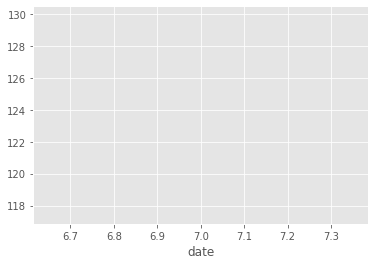

In [202]:
short_tweets_syr['text'].str.len().groupby(by=short_tweets_syr.index.month).mean().plot()

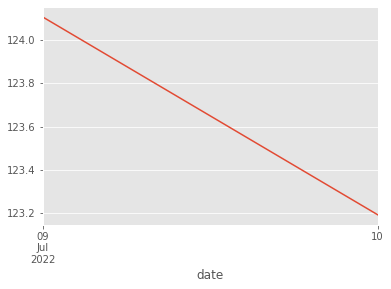

In [203]:
short_tweets_syr['text'].str.len().resample('D').mean().plot() 

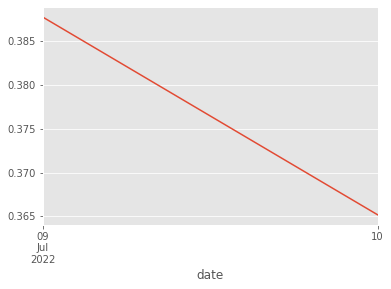

In [204]:
short_tweets_syr['positivity'].resample('D').mean().plot() 

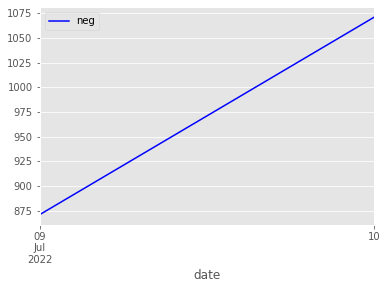

In [205]:
short_tweets_syr['negative'].resample('D').sum().plot(color = 'b',label = 'neg').legend() 

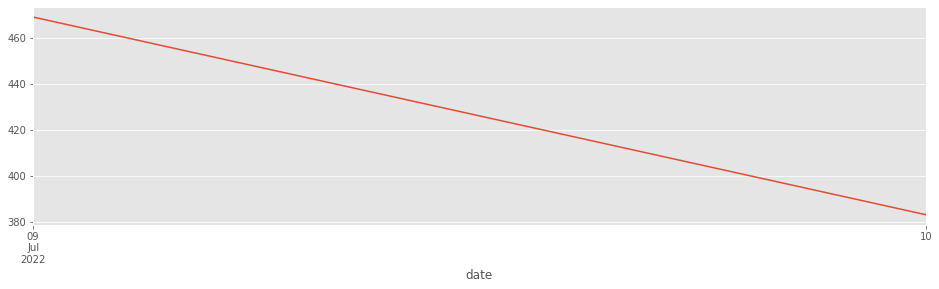

In [206]:
short_tweets_syr['anger'].resample('D').sum().plot(figsize=(16,4))

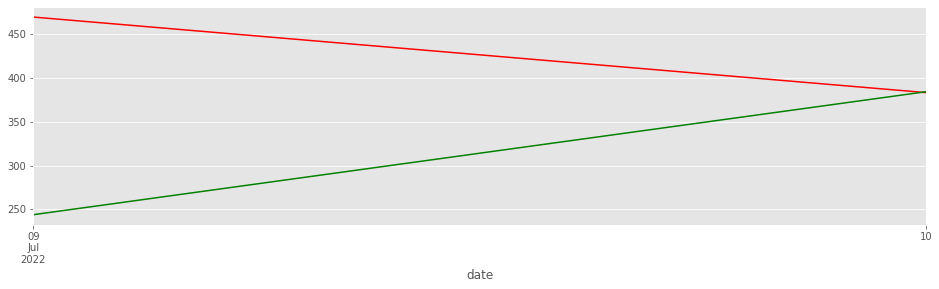

In [207]:
ax = short_tweets_syr['anger'].resample('D').sum().plot(figsize=(16,4), color = 'red')
short_tweets_syr['joy'].resample('D').sum().plot(figsize=(16,4), ax = ax, color = 'green')

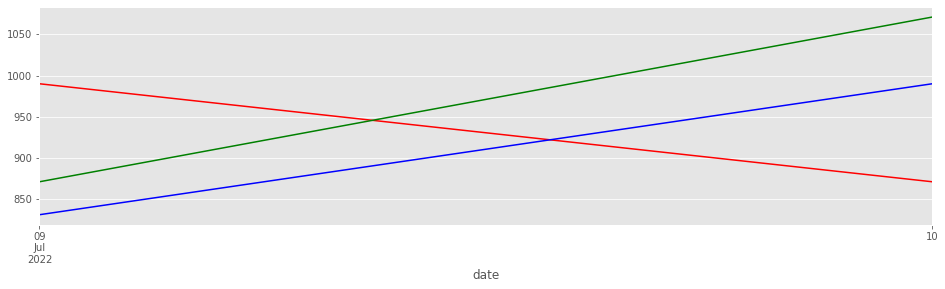

In [208]:
ax = short_tweets_syr['positivity'].resample('D').sum().plot(figsize=(16,4), color = 'red')
short_tweets_syr['negative'].resample('D').sum().plot(figsize=(16,4), ax = ax, color = 'green')
short_tweets_syr['trust'].resample('D').sum().plot(figsize=(16,4), ax = ax, color = 'blue')

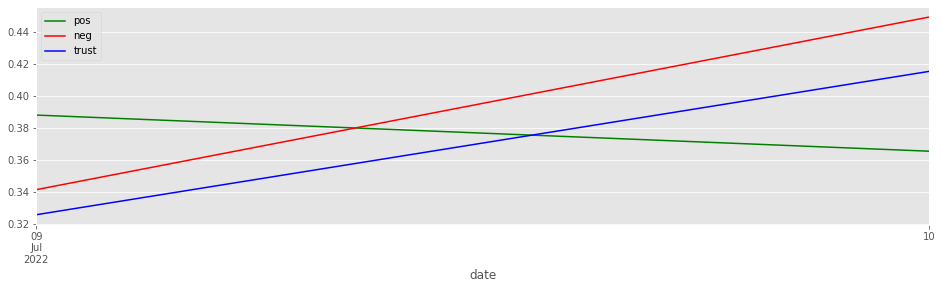

In [209]:
ax = short_tweets_syr['positivity'].resample('D').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_syr['negative'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_syr['trust'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

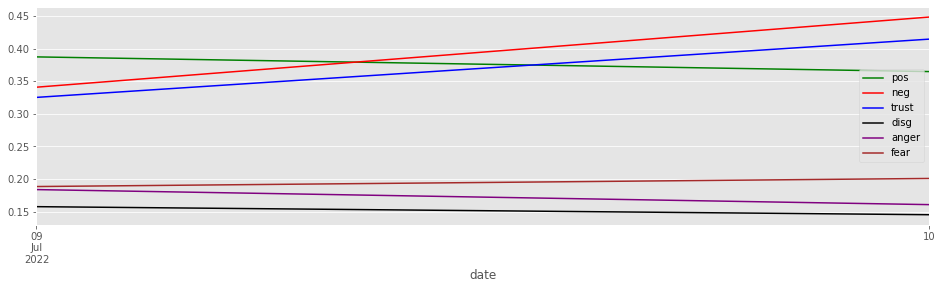

In [210]:
plt.style.use('ggplot')
ax = short_tweets_syr['positivity'].resample('D').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_syr['negative'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_syr['trust'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

short_tweets_syr['disgust'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'disg',color = 'black').legend() 

short_tweets_syr['anger'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'anger',color = 'purple').legend() 

short_tweets_syr['fear'].resample('D').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'fear',color = 'brown').legend()    

Text(0, 0.5, 'Years')

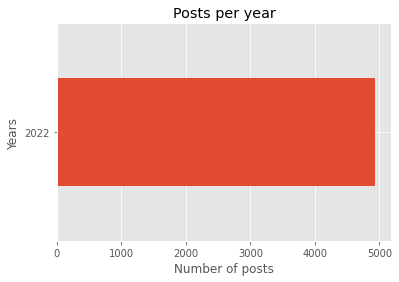

In [211]:
short_tweets_syr['text'].groupby(by=short_tweets_syr.index.year).count().plot(kind='barh')
plt.title("Posts per year")
plt.xlabel("Number of posts")
plt.ylabel("Years")

Text(0, 0.5, 'Month of the year')

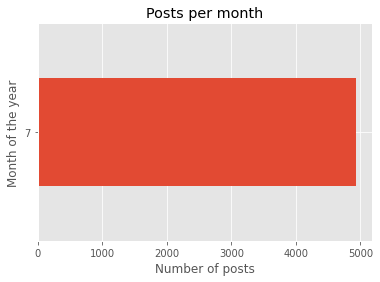

In [212]:
short_tweets_syr['text'].groupby(by=short_tweets_syr.index.month).count().plot(kind='barh')
plt.title("Posts per month")
plt.xlabel("Number of posts")
plt.ylabel("Month of the year")

Text(0, 0.5, 'Hour of the day')

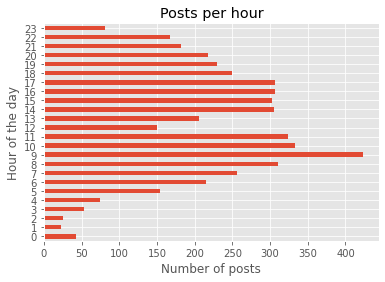

In [213]:
short_tweets_syr['text'].groupby(by=short_tweets_syr.index.hour).count().plot(kind='barh')
plt.title("Posts per hour")
plt.xlabel("Number of posts")
plt.ylabel("Hour of the day")

# neadf - syrdf

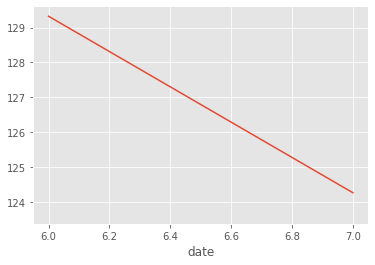

In [214]:
short_tweets_nea['text'].str.len().groupby(by=short_tweets_nea.index.month).mean().plot()
short_tweets_syr['text'].str.len().groupby(by=short_tweets_syr.index.month).mean().plot()

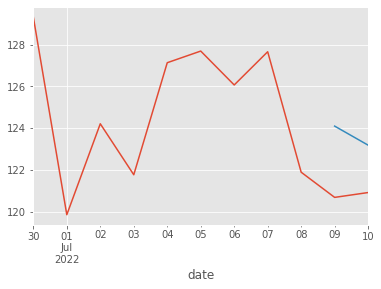

In [215]:
short_tweets_nea['text'].str.len().resample('D').mean().plot() 
short_tweets_syr['text'].str.len().resample('D').mean().plot() 

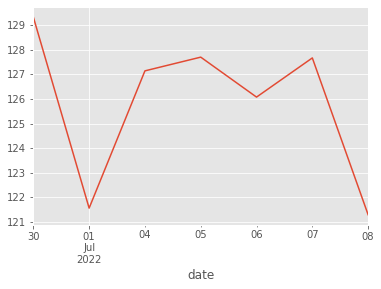

In [216]:
short_tweets_nea['text'].str.len().resample('B').mean().plot() 
short_tweets_syr['text'].str.len().resample('B').mean().plot() 

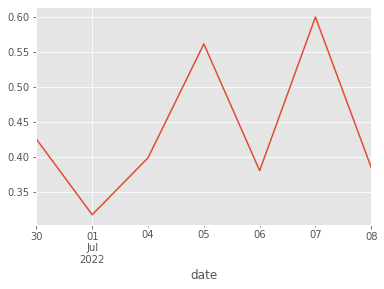

In [217]:
short_tweets_nea['positivity'].resample('B').mean().plot() 
short_tweets_syr['positivity'].resample('B').mean().plot() 

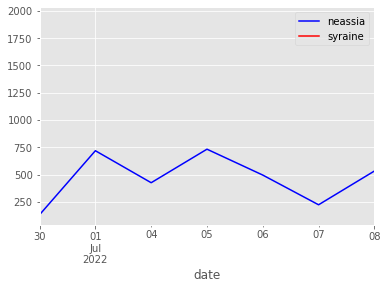

In [218]:
short_tweets_nea['negative'].resample('B').sum().plot(color = 'b',label = 'neassia').legend() 
short_tweets_syr['negative'].resample('B').sum().plot(color = 'r',label = 'syraine').legend() 

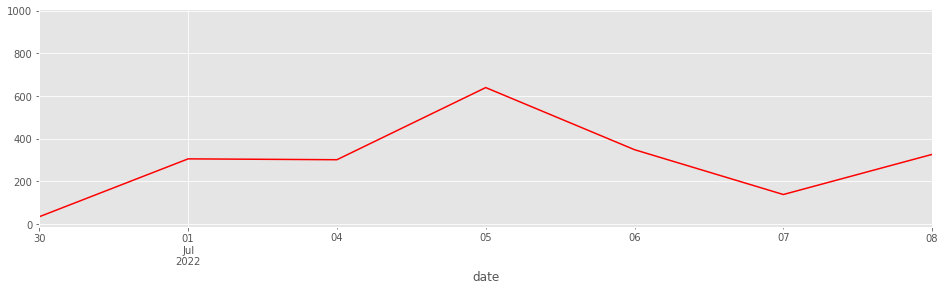

In [219]:
short_tweets_nea['fear'].resample('B').sum().plot(figsize=(16,4), color = 'red')
short_tweets_syr['fear'].resample('B').sum().plot(figsize=(16,4), color = 'blue')

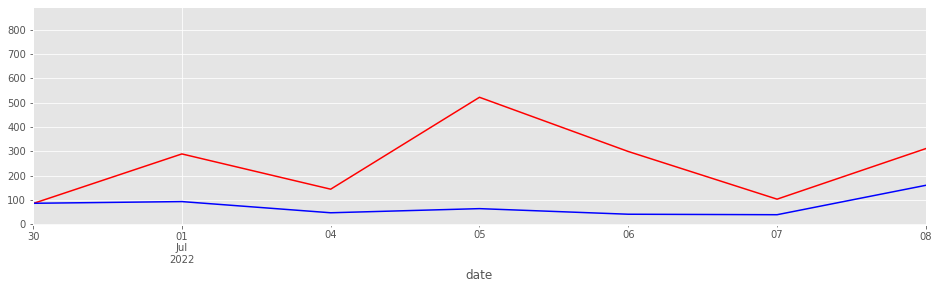

In [220]:
ax = short_tweets_nea['anger'].resample('B').sum().plot(figsize=(16,4), color = 'red')
short_tweets_nea['joy'].resample('B').sum().plot(figsize=(16,4), ax = ax, color = 'blue')
ax = short_tweets_syr['anger'].resample('B').sum().plot(figsize=(16,4), color = 'yellow')
short_tweets_syr['joy'].resample('B').sum().plot(figsize=(16,4), ax = ax, color = 'green')

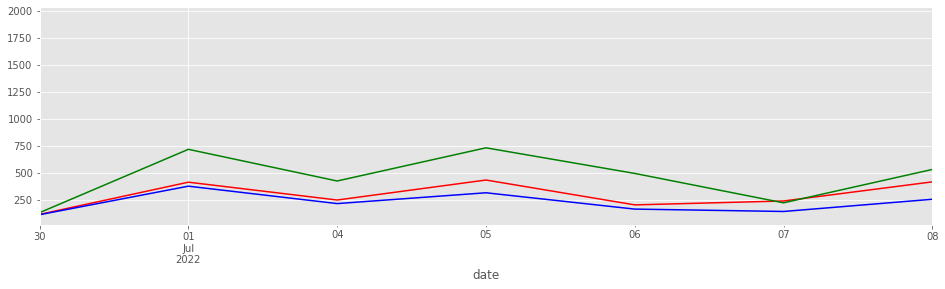

In [221]:
ax = short_tweets_nea['positivity'].resample('B').sum().plot(figsize=(16,4), color = 'red')
short_tweets_nea['negative'].resample('B').sum().plot(figsize=(16,4), ax = ax, color = 'green')
short_tweets_nea['trust'].resample('B').sum().plot(figsize=(16,4), ax = ax, color = 'blue')
ax = short_tweets_syr['positivity'].resample('B').sum().plot(figsize=(16,4), color = 'yellow')
short_tweets_syr['negative'].resample('B').sum().plot(figsize=(16,4), ax = ax, color = 'purple')
short_tweets_syr['trust'].resample('B').sum().plot(figsize=(16,4), ax = ax, color = 'orange')

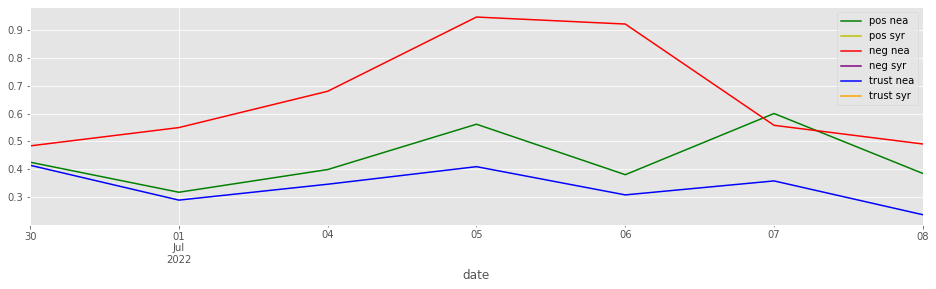

In [222]:
ax = short_tweets_nea['positivity'].resample('B').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos nea')
ax = short_tweets_syr['positivity'].resample('B').mean().plot(figsize=(16,4), 
                                                          color = 'y', label='pos syr')
short_tweets_nea['negative'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg nea', color = 'r')
short_tweets_syr['negative'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg syr', color = 'purple')
short_tweets_nea['trust'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust nea',color = 'blue').legend()
short_tweets_syr['trust'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust syr',color = 'orange').legend()

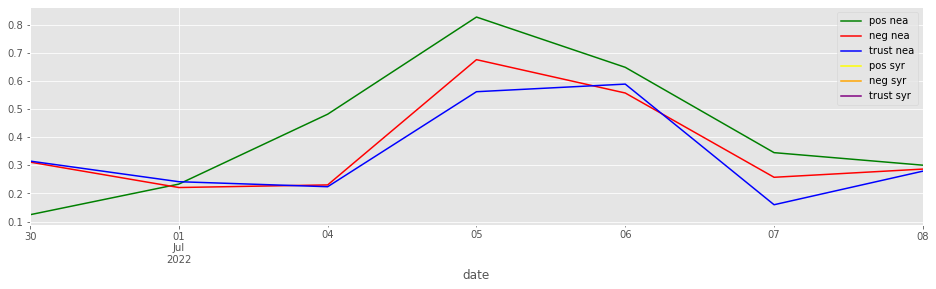

In [223]:
plt.style.use('ggplot')
ax = short_tweets_nea['fear'].resample('B').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos nea')
short_tweets_nea['anger'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg nea', color = 'r')
short_tweets_nea['disgust'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust nea',color = 'blue').legend()    
short_tweets_syr['fear'].resample('B').mean().plot(figsize=(16,4), 
                                                          color = 'yellow', label='pos syr')
short_tweets_syr['anger'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg syr', color = 'orange')
short_tweets_syr['disgust'].resample('B').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust syr',color = 'purple').legend()                                                